In [ ]:
from google.colab import files, drive

#uploaded = files.upload()
drive.mount('/content/drive/', force_remount=True)


Mounted at /content/drive/


In [ ]:
!cp /content/drive/'My Drive'/Research_project/all_functions/archs_lether.py ./
!cp /content/drive/'My Drive'/Research_project/all_functions/utils.py ./
!cp /content/drive/'My Drive'/Research_project/all_functions/datasets.py ./
!cp /content/drive/'My Drive'/Research_project/all_functions/dataset.py ./
!cp /content/drive/'My Drive'/Research_project/all_functions/metrics.py ./

# !cp -r /content/drive/'My Drive'/Research_project/leather ./

%ls

archs_lether.py  datasets.py  metrics.py    utils.py
dataset.py       drive/       sample_data/


In [ ]:
import os
import numpy as np
import pandas as pd
import matplotlib.pyplot as plt
import argparse
import joblib
from tqdm import tqdm 
#import glob
from glob import glob
import datetime
import cv2 

import torch
import torch.nn as nn
import torch.backends.cudnn as cudnn
from torch.nn import functional as F
#import torch.nn.functional as F
import torch.optim as optim
from torch.optim import lr_scheduler
from torch.optim.lr_scheduler import ReduceLROnPlateau
from torch.utils.data import Dataset
from torch.utils.data import DataLoader

from torchvision import datasets, transforms, models
from collections import OrderedDict
from sklearn.model_selection import train_test_split
from sklearn.manifold import TSNE
from torchvision.utils import make_grid

In [ ]:
import sys
sys.path.append('/content/drive/My Drive/Research_project/CAVGA/')

from model_GVAE import Encoder, Decod
from data_loader import Data_Loader
# https://github.com/utkuozbulak/pytorch-cnn-visualizations/blob/16eddfa055a9c618ba548e9fb4529e2ccbc79c35/src/misc_functions.py#L53

In [ ]:
from dataset import Data_set_loader, data_set_gen
import archs_lether, datasets
from utils import *

In [ ]:
'''
Initilize the Model with Backbone network, dataset, batchsize etc
'''

def parse_args():
    parser = argparse.ArgumentParser()  

    parser.add_argument('--name', default='VAE_GAN', help='model name') 
    parser.add_argument('--arch', default='ResNet18')
    parser.add_argument('--backbone', default='resnet18')
    parser.add_argument('--dataset', default='leather') # capsule, leather ========== type of Dataset ==========
    parser.add_argument('--metric', default='adacos')
    parser.add_argument('--num-features', default=512, type=int,
                        help='dimention of embedded features')
    parser.add_argument('--num-classes', default=10, type=int)
    parser.add_argument('-b', '--batch-size', default=8, type=int,
                        metavar='N', help='mini-batch size (default: 8)')
    parser.add_argument('--epochs', default=150, type=int)
    parser.add_argument('--lr', '--learning-rate', default=1e-1, type=float)
    parser.add_argument('--min-lr', default=1e-3, type=float)
    parser.add_argument('--momentum', default=0.9, type=float)
    parser.add_argument('--weight-decay', default=1e-4, type=float)
    
    args = parser.parse_args()

    return args

In [ ]:
# for passing arguments
import sys
if sys.argv:
        del sys.argv[1:]

In [ ]:
args = parse_args()
device = torch.device("cuda" if torch.cuda.is_available() else "cpu") 
print(device)

print('Details of System ------------------------')
for arg in vars(args):
    print('%s: %s' % (arg, getattr(args, arg)))
print('----------------------------------------')


criterion = nn.CrossEntropyLoss().to(device)

cudnn.benchmark = True

cuda
Details of System ------------------------
name: VAE_GAN
arch: ResNet18
backbone: resnet18
dataset: leather
metric: adacos
num_features: 512
num_classes: 10
batch_size: 8
epochs: 150
lr: 0.1
min_lr: 0.001
momentum: 0.9
weight_decay: 0.0001
----------------------------------------


In [ ]:
if args.dataset == 'capsule':
    base_dir = '/content/drive/My Drive/Research_project/capsule/'
    
    add_dir = 'train/good/'
    img_paths_train_good = glob(base_dir + add_dir + '*.png')
    labels_train_good = [0 for p in img_paths_train_good]
    
    add_dir = 'test/good/'
    img_paths_test_good = glob(base_dir + add_dir + '*.png')
    labels_test_good = [0 for p in img_paths_test_good]
    
    add_dir = 'test/crack/'
    img_paths_test_bad = glob(base_dir + add_dir + '*.png')
    add_dir = 'test/faulty_imprint/'
    img_paths_test_bad.extend(glob(base_dir + add_dir + '*.png'))
    add_dir = 'test/poke/'
    img_paths_test_bad.extend(glob(base_dir + add_dir + '*.png'))
    add_dir = 'test/scratch/'
    img_paths_test_bad.extend(glob(base_dir + add_dir + '*.png')) 
    add_dir = 'test/squeeze/'
    img_paths_test_bad.extend(glob(base_dir + add_dir + '*.png'))
    labels_test_bad = [1 for p in img_paths_test_bad]
    
if args.dataset == 'leather':
    base_dir = '/content/drive/My Drive/Research_project/leather/'
    
    add_dir = 'train/good/'
    img_paths_train_good = glob(base_dir + add_dir + '*.png')
    labels_train_good = [0 for p in img_paths_train_good]
    
    add_dir = 'test/good/'
    img_paths_test_good = glob(base_dir + add_dir + '*.png')
    labels_test_good = [0 for p in img_paths_test_good]
    
    add_dir = 'test/color/'
    img_paths_test_bad = glob(base_dir + add_dir + '*.png')
    add_dir = 'test/cut/'
    img_paths_test_bad.extend(glob(base_dir + add_dir + '*.png'))
    add_dir = 'test/fold/'
    img_paths_test_bad.extend(glob(base_dir + add_dir + '*.png'))
    add_dir = 'test/glue/'
    img_paths_test_bad.extend(glob(base_dir + add_dir + '*.png')) 
    add_dir = 'test/poke/'
    img_paths_test_bad.extend(glob(base_dir + add_dir + '*.png'))
    labels_test_bad = [1 for p in img_paths_test_bad]

In [ ]:
print(len(img_paths_train_good))
print(len(img_paths_test_good))
print(len(img_paths_test_bad))
print(len(labels_train_good))
print(labels_test_good)
print(len(labels_test_bad))

245
32
92
245
[0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0]
92


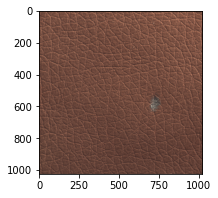

In [ ]:
for i in range(len(img_paths_test_bad)):
    filename = img_paths_test_bad[i]
    test_image = Image.open(filename)  
    plt.figure(figsize=(3,3))
    plt.imshow(test_image)
    break 

In [ ]:
train_img_paths_train_good, test_img_paths_train_good, train_labels_train_good, test_labels_train_good = train_test_split(
    img_paths_train_good, 
    labels_train_good, 
    test_size=0.2, random_state=41, stratify=labels_train_good)

train_img_paths_test_good, test_img_paths_test_good, train_labels_test_good, test_labels_test_good = train_test_split(
    img_paths_test_good, 
    labels_test_good, 
    test_size=0.2, random_state=41, stratify=labels_test_good)

train_img_paths_test_bad, test_img_paths_test_bad, train_labels_test_bad, test_labels_test_bad = train_test_split(
    img_paths_test_bad, 
    labels_test_bad, 
    test_size=0.2, random_state=41, stratify=labels_test_bad)

In [ ]:
train_img_paths = train_img_paths_train_good + train_img_paths_test_good + train_img_paths_test_bad
test_img_paths = test_img_paths_train_good + test_img_paths_test_good + test_img_paths_test_bad

train_labels =  train_labels_train_good + train_labels_test_good + train_labels_test_bad
test_labels =  test_labels_train_good + test_labels_test_good + test_labels_test_bad

In [ ]:
transform_mvtec_train = transforms.Compose([transforms.Resize((300,300)),
                                      transforms.RandomCrop((256,256)),
                                      #transforms.RandomHorizontalFlip(p=0.5),
                                      #transforms.RandomVerticalFlip(p=0.5),
                                      transforms.ToTensor()])

transform_mvtec_test = transforms.Compose([transforms.Resize((256, 256)),
                                           transforms.ToTensor()])

In [ ]:
    train_set = datasets.MVTec_dataset(
        train_img_paths,
        train_labels,
        transform=transform_mvtec_train)

    test_set = datasets.MVTec_dataset(
        test_img_paths,
        test_labels,
        transform=transform_mvtec_test)

In [ ]:
    train_loader = torch.utils.data.DataLoader(
        train_set,
        batch_size=args.batch_size,
        shuffle=True,
        num_workers=0)

    test_loader = torch.utils.data.DataLoader(
        test_set,
        batch_size=args.batch_size,
        shuffle=False,
        num_workers=0)

In [ ]:
class AdaCos(nn.Module):
    def __init__(self, num_features, num_classes, m=0.50):
        super(AdaCos, self).__init__()
        self.num_features = num_features
        self.n_classes = num_classes
        self.s = math.sqrt(2) * math.log(num_classes - 1)
        self.m = m
        self.W = Parameter(torch.FloatTensor(num_classes, num_features))
        nn.init.xavier_uniform_(self.W)

    def forward(self, input, label=None):
        # normalize features
        x = F.normalize(input)
        # normalize weights
        W = F.normalize(self.W)
        # dot product
        logits = F.linear(x, W)
        if label is None:
            return logits
        # feature re-scale
        theta = torch.acos(torch.clamp(logits, -1.0 + 1e-7, 1.0 - 1e-7))
        one_hot = torch.zeros_like(logits)
        one_hot.scatter_(1, label.view(-1, 1).long(), 1)
        with torch.no_grad():
            B_avg = torch.where(one_hot < 1, torch.exp(self.s * logits), torch.zeros_like(logits))
            B_avg = torch.sum(B_avg) / input.size(0)
            # print(B_avg)
            theta_med = torch.median(theta[one_hot == 1])
            self.s = torch.log(B_avg) / torch.cos(torch.min(math.pi/4 * torch.ones_like(theta_med), theta_med))
        output = self.s * logits

        return output

In [ ]:
from torch.nn import Parameter
metric_fc = AdaCos(num_features=args.num_features, num_classes=args.num_classes).to(device)

In [ ]:
class ResNet_(nn.Module):
    def __init__(self, args):
        super().__init__()

        self.backbone = models.resnet18(pretrained=True)
        last_channels = 512
        #last_channels = 2
        
            
        self.features = nn.Sequential(
            self.backbone.conv1,
            self.backbone.bn1,
            self.backbone.relu,
            self.backbone.layer1,
            self.backbone.layer2,
            self.backbone.layer3,
            self.backbone.layer4)

        self.bn1 = nn.BatchNorm2d(last_channels)
        self.dropout = nn.Dropout2d(0.5)
        self.fc = nn.Linear(16*16*last_channels, args.num_features)
        #self.fc = nn.Linear(524288, args.num_features)
        self.bn2 = nn.BatchNorm1d(args.num_features)

    def freeze_bn(self):
        for m in self.features.modules():
            if isinstance(m, nn.BatchNorm2d):
                m.weight.requires_grad = False
                m.bias.requires_grad = False

    def forward(self, x):
        x = self.features(x)
        #print(x.shape)
        x = self.bn1(x)
        x = self.dropout(x)
        x = x.view(x.shape[0], -1)
        x = self.fc(x)
        output = self.bn2(x)

        return output

In [ ]:
class VAE(nn.Module):
    def __init__(self, args):
        super(VAE, self).__init__()

        # encoder ********************************
        self.resnet = ResNet_(args)

        '''self.E_layer1_8 = nn.Sequential(nn.Conv2d(in_channels=3, out_channels=64, kernel_size=(4,4), stride=2, padding=1),
                                      nn.LeakyReLU(0.2, inplace=True),
                                      nn.Conv2d(in_channels=64, out_channels=128, kernel_size=(4,4), stride=2, padding=1),
                                      nn.BatchNorm2d(num_features=128),
                                      nn.LeakyReLU(0.2, inplace=True),
                                      nn.Conv2d(in_channels=128, out_channels=256, kernel_size=(4,4), stride=2, padding=1),
                                      nn.BatchNorm2d(num_features=256),
                                      nn.LeakyReLU(0.2, inplace=True),
                                      nn.Conv2d(in_channels=256, out_channels=512, kernel_size=(4,4), stride=2, padding=1),
                                      nn.BatchNorm2d(num_features=512),
                                      nn.LeakyReLU(0.2, inplace=True),
                                      nn.Conv2d(in_channels=512, out_channels=512, kernel_size=(4,4), stride=2, padding=1))
        self.E_bn_relu = nn.Sequential(nn.BatchNorm2d(num_features=512),
                                      nn.ReLU(inplace=True))
                                      '''

        
        # *******************************************************

        # decoder
        self.dim = 512*16*16
        self.fc_d = nn.Sequential(
            nn.Linear(args.num_features, self.dim),
            nn.BatchNorm1d(self.dim),
            nn.LeakyReLU(0.2),
        )
        self.decoder = Decod()

    def reparameterize(self, mu, logvar):
        if self.training:
            std = logvar.mul(0.5).exp_()
            eps = std.new(std.size()).normal_()
            return eps.mul(std).add_(mu)
        else:
            return mu

    def decode(self, z):
        h = self.fc_d(z)
        h = h.view(-1, 512, 16, 16)
        return self.decoder(h)

    def encoder(self, x):
        x = self.resnet(x)   # ouput each = (8,512)
        return x


    def forward(self, x):
        mu, logvar = self.encoder(x), self.encoder(x)   # ouput each = (8,512)
        #print('sizes ---------- ', mu.shape, logvar.shape)
        self.mu = mu
        self.logvar = logvar
        z = self.reparameterize(mu, logvar)
        x_hat = self.decode(z)
        return x_hat, mu, logvar

# custom weights initialization called on G and D
def weights_init(m):
    classname = m.__class__.__name__
    if classname.find('Conv') != -1:
        #m.weight.data.normal_(0.0, 0.02)
        nn.init.xavier_normal_(m.weight.data)
    elif classname.find('BatchNorm') != -1:
        m.weight.data.normal_(1.0, 0.02)
        m.bias.data.fill_(0)
    if classname.find('ConvTranspose') != -1:
        #m.weight.data.normal_(0.0, 0.02)
        nn.init.xavier_normal_(m.weight.data)

In [ ]:
class Discriminator(nn.Module):
    def __init__(self):
      super(Discriminator, self).__init__()

      self.dim = 512*8*8
      self.layer1_13 = nn.Sequential(
          nn.Conv2d(in_channels=3, out_channels=64, kernel_size=(4,4), stride=2, padding=1),
          # for gray images
          #nn.Conv2d(in_channels=1, out_channels=64, kernel_size=(4,4), stride=2, padding=1),
          nn.LeakyReLU(0.2, inplace=True),
          nn.Conv2d(in_channels=64, out_channels=128, kernel_size=(4,4), stride=2, padding=1),
          nn.BatchNorm2d(num_features=128),
          nn.LeakyReLU(0.2, inplace=True),
          nn.Conv2d(in_channels=128, out_channels=256, kernel_size=(4,4), stride=2, padding=1),
          nn.BatchNorm2d(num_features=256),
          nn.LeakyReLU(0.2, inplace=True),
          nn.Conv2d(in_channels=256, out_channels=512, kernel_size=(4,4), stride=2, padding=1),
          nn.BatchNorm2d(num_features=512),
          nn.LeakyReLU(0.2, inplace=True),
          nn.Conv2d(in_channels=512, out_channels=512, kernel_size=(4,4), stride=2, padding=1),
          nn.Sigmoid()
      )
      self.linear = nn.Sequential(nn.Linear(self.dim, 1024),
                                  nn.BatchNorm1d(1024),                    
                                  nn.LeakyReLU(0.2, True),
                                  nn.Linear(1024, 1),
                                  nn.Sigmoid())

    def forward(self, input):
      x = self.layer1_13(input)
      x = x.view(x.size(0), -1)
      #x=x.view(-1, 512*8*8)
      x= self.linear(x)
      return x.squeeze(1)

# --------------------------------------------------------------------------------------

def loss_function(recon_x,x,mean,logstd):
    BCE = F.binary_cross_entropy(recon_x,x,reduction='sum')
   
    # Because var is the natural logarithm of the standard deviation, 
    # first find the natural logarithm and then square it to convert to variance
    var = torch.pow(torch.exp(logstd),2)
    KLD = -0.5 * torch.sum(1+torch.log(var)-torch.pow(mean,2)-var)
    return BCE+KLD

In [ ]:
def vae_gan_train(args, input, vae, D, optimizer ):
    ###################################################################
    #           Initilization
    ###################################################################
    z_dim = 512
    nz=z_dim
    

    #print("Random Seed: 11")
    random.seed(11)
    torch.manual_seed(11)
    device = 'cuda' if torch.cuda.is_available() else 'cpu'

    data = input.to(device)
    # Can optimize operating efficiency
    cudnn.benchmark = True

    vae = vae.to(device)
    D = D.to(device)

    criterion = nn.BCELoss().to(device)
    MSECriterion = nn.MSELoss().to(device)
    l1_loss = nn.L1Loss()

    #print("=====> Setup optimizer")
    optimizerD = optim.Adam(D.parameters(), lr=0.0001, weight_decay=5e-4)
    optimizerVAE = optim.Adam(vae.parameters(), lr=0.0001, weight_decay=5e-4)

    gen_win = None
    rec_win = None

    ###################################################
    # (2) Update G network which is the decoder of VAE
    ###################################################
    recon_data,mean,logstd = vae(data)
    #print('recon Data =  ',recon_data.shape,'original Data =  ', data.shape)
    vae.zero_grad()
    vae_loss = loss_function(recon_data,data,mean,logstd)
    vae_loss.backward(retain_graph=True)
    optimizerVAE.step()
    
    ###################################################################
    # (1) Update D network: maximize log(D(x)) + log(1 - D(G(z)))
    ###################################################################
    # train with real
    D.zero_grad()
    
    #label = label.to(device)
    batch_size = data.shape[0]
    output = D(data)
    #print("output size of netDs: ", output.size())

    real_label = (torch.ones(batch_size)*0.95).to(device)  # Define the real image label as 1
    fake_label = (torch.ones(batch_size)*0.05).to(device)  # Define the label of the fake picture as 0
    errD_real = criterion(output, real_label)
    errD_real.backward()
    real_data_score = output.mean().item()

    # train with fake, taking the noise vector z as the input of D network
    # Randomly generate a latent variable, and then generate a picture through the decoder
    z = torch.randn(batch_size, nz).to(device)
    # Turn the latent variable z into a fake picture through vae's decoder
    fake_data = vae.decode(z)
    #print(fake_data.shape)
    output = D(fake_data)
    errD_fake = criterion(output, fake_label)
    errD_fake.backward()
    # fake_data_score Used to output the score of the fake photo, 0 is the most false, 1 is true
    fake_data_score = output.data.mean()
    errD = errD_real + errD_fake  # Discriminator Loss
    optimizerD.step()

    ###############################################
    # (3) Update G network: maximize log(D(G(z)))
    ###############################################
    vae.zero_grad()
    real_label = torch.ones(batch_size).to(device)  # Define the real image label as 1
    recon_data,mean,logstd = vae(data)
    output = D(recon_data)
    errVAE = criterion(output, real_label)
    abs_loss = l1_loss(recon_data, data) # Generator Loss
    errVAE.backward()
    D_G_z2 = output.mean().item()
    optimizerD.step()

    ############################################### End of Training Code
        
    D_Losses.append(errD.item())
    G_Losses.append(abs_loss.item())
    
    z = vae.encoder(data)
    return z, real_data_score, fake_data_score, errD.item(), errVAE.item()

In [ ]:
def train(args, train_loader,resN, model,D, metric_fc, criterion, optimizer, epoch):
    losses = AverageMeter()
    acc1s = AverageMeter()
    acc5s = AverageMeter()

    model.train()
    resN.train()
    metric_fc.train()

    for i, (input, target) in tqdm(enumerate(train_loader), total=len(train_loader)):
        input = input.to(device)
        target = target.long().to(device) 

        #********************** VAE Training *******************
        z, real_score, fake_score, errD, errVAE = vae_gan_train(args, input, model, D, optimizer )
        #*********************************************

        for i in range(3):
            feature = resN(input)
            output = metric_fc(feature, target)
            loss = criterion(output, target)

        acc1, acc5 = accuracy(output, target, topk=(1, 5))

        losses.update(loss.item(), input.size(0))
        acc1s.update(acc1.item(), input.size(0))
        acc5s.update(acc5.item(), input.size(0))
        E_Losses.append(loss.item())

        # compute gradient and do optimizing step based on Adacos
        optimizer.zero_grad()
        loss.backward()
        optimizer.step()

    log = OrderedDict([
        ('loss', losses.avg),
        ('acc@1', acc1s.avg),
        ('acc@5', acc5s.avg),
    ])

    if epoch %5 == 0:
        x_0,_ = iter(test_loader).next()
        recon_x,_,_ = model(x_0.to(device))
        fake_images = make_grid(recon_x.cpu(), nrow=8, normalize=True).detach()
        plt.imshow(np.transpose((fake_images), [1, 2, 0])[:,:,0:3], interpolation="bicubic")
        plt.show()

        print('real_score: %.4f fake_score: %.4f Loss_D: %.4f errVAE: %4f'
              % (real_score, fake_score, errD, errVAE))

    return log

def validate(args, val_loader,resN, model, metric_fc, criterion):
    losses = AverageMeter()
    acc1s = AverageMeter()
    acc5s = AverageMeter()

    # switch to evaluate mode
    model.eval()
    resN.eval()
    metric_fc.eval()

    with torch.no_grad():
        for i, (input, target) in tqdm(enumerate(val_loader), total=len(val_loader)):
            input = input.to(device)
            target = target.long().to(device) 

            feature = resN(input)
            output = metric_fc(feature)
            loss = criterion(output, target)

            acc1, acc5 = accuracy(output, target, topk=(1, 5))

            losses.update(loss.item(), input.size(0))
            acc1s.update(acc1.item(), input.size(0))
            acc5s.update(acc5.item(), input.size(0))

    log = OrderedDict([
        ('loss', losses.avg),
        ('acc@1', acc1s.avg),
        ('acc@5', acc5s.avg),
    ])

    return log

In [ ]:
D = Discriminator()
model = VAE(args)
resN = ResNet_(args)
model = model.to(device)
D = D.to(device)
resN = resN.to(device)

Downloading: "https://download.pytorch.org/models/resnet18-5c106cde.pth" to /root/.cache/torch/hub/checkpoints/resnet18-5c106cde.pth


/usr/local/lib/python3.7/dist-packages/torch/optim/lr_scheduler.py:134: UserWarning: Detected call of `lr_scheduler.step()` before `optimizer.step()`. In PyTorch 1.1.0 and later, you should call them in the opposite order: `optimizer.step()` before `lr_scheduler.step()`.  Failure to do this will result in PyTorch skipping the first value of the learning rate schedule. See more details at https://pytorch.org/docs/stable/optim.html#how-to-adjust-learning-rate
  "https://pytorch.org/docs/stable/optim.html#how-to-adjust-learning-rate", UserWarning)
  0%|          | 0/37 [00:00<?, ?it/s]

Epoch [1/150]


100%|██████████| 37/37 [02:59<00:00,  4.84s/it]


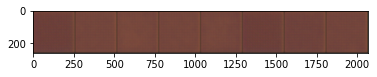

  0%|          | 0/10 [00:00<?, ?it/s]

real_score: 0.6392 fake_score: 0.5294 Loss_D: 1.3289 errVAE: 0.511025


100%|██████████| 10/10 [00:36<00:00,  3.67s/it]
/usr/local/lib/python3.7/dist-packages/torch/optim/lr_scheduler.py:509: UserWarning: To get the last learning rate computed by the scheduler, please use `get_last_lr()`.
  "please use `get_last_lr()`.", UserWarning)


loss 1.8672 - acc@1 65.9864 - acc@5 72.1088 - val_loss 2.0421 - val_acc@1 69.3333 - val_acc@5 72.0000


  0%|          | 0/37 [00:00<?, ?it/s]

=> saved best model
Epoch [2/150]


  0%|          | 0/37 [00:00<?, ?it/s]

loss 1.1131 - acc@1 84.3537 - acc@5 91.8367 - val_loss 2.1352 - val_acc@1 69.3333 - val_acc@5 69.3333
Epoch [3/150]


100%|██████████| 10/10 [00:03<00:00,  2.62it/s]


loss 1.0625 - acc@1 84.3537 - acc@5 92.5170 - val_loss 1.6236 - val_acc@1 88.0000 - val_acc@5 98.6667


  0%|          | 0/37 [00:00<?, ?it/s]

=> saved best model
Epoch [4/150]


100%|██████████| 10/10 [00:03<00:00,  2.53it/s]


loss 1.0401 - acc@1 85.0340 - acc@5 93.8776 - val_loss 1.5746 - val_acc@1 89.3333 - val_acc@5 98.6667


  0%|          | 0/37 [00:00<?, ?it/s]

=> saved best model
Epoch [5/150]


  0%|          | 0/37 [00:00<?, ?it/s]

loss 1.0018 - acc@1 88.0952 - acc@5 93.8776 - val_loss 1.5805 - val_acc@1 89.3333 - val_acc@5 100.0000
Epoch [6/150]


100%|██████████| 37/37 [01:09<00:00,  1.87s/it]


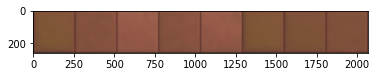

  0%|          | 0/10 [00:00<?, ?it/s]

real_score: 0.7785 fake_score: 0.3985 Loss_D: 0.8885 errVAE: 0.303647


  0%|          | 0/37 [00:00<?, ?it/s]

loss 0.9616 - acc@1 90.4762 - acc@5 94.5578 - val_loss 1.6855 - val_acc@1 80.0000 - val_acc@5 92.0000
Epoch [7/150]


  0%|          | 0/37 [00:00<?, ?it/s]

loss 0.9221 - acc@1 90.8163 - acc@5 96.2585 - val_loss 1.6626 - val_acc@1 85.3333 - val_acc@5 90.6667
Epoch [8/150]


  0%|          | 0/37 [00:00<?, ?it/s]

loss 0.9259 - acc@1 92.5170 - acc@5 94.8980 - val_loss 1.6204 - val_acc@1 85.3333 - val_acc@5 93.3333
Epoch [9/150]


  0%|          | 0/37 [00:00<?, ?it/s]

loss 0.9046 - acc@1 92.5170 - acc@5 95.2381 - val_loss 1.6424 - val_acc@1 89.3333 - val_acc@5 92.0000
Epoch [10/150]


  0%|          | 0/37 [00:00<?, ?it/s]

loss 0.8843 - acc@1 93.5374 - acc@5 95.5782 - val_loss 1.5910 - val_acc@1 88.0000 - val_acc@5 94.6667
Epoch [11/150]


100%|██████████| 37/37 [01:09<00:00,  1.88s/it]


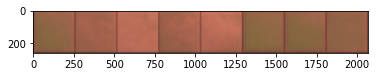

  0%|          | 0/10 [00:00<?, ?it/s]

real_score: 0.8572 fake_score: 0.3437 Loss_D: 0.7815 errVAE: 0.153471


100%|██████████| 10/10 [00:03<00:00,  2.53it/s]


loss 0.8665 - acc@1 94.2177 - acc@5 96.2585 - val_loss 1.5643 - val_acc@1 86.6667 - val_acc@5 100.0000


  0%|          | 0/37 [00:00<?, ?it/s]

=> saved best model
Epoch [12/150]


  0%|          | 0/37 [00:00<?, ?it/s]

loss 0.8871 - acc@1 91.8367 - acc@5 96.5986 - val_loss 1.7597 - val_acc@1 78.6667 - val_acc@5 82.6667
Epoch [13/150]


  0%|          | 0/37 [00:00<?, ?it/s]

loss 0.8820 - acc@1 93.1973 - acc@5 96.2585 - val_loss 1.7479 - val_acc@1 74.6667 - val_acc@5 89.3333
Epoch [14/150]


100%|██████████| 10/10 [00:03<00:00,  2.64it/s]


loss 0.8660 - acc@1 93.1973 - acc@5 95.9184 - val_loss 1.5208 - val_acc@1 92.0000 - val_acc@5 100.0000


  0%|          | 0/37 [00:00<?, ?it/s]

=> saved best model
Epoch [15/150]


100%|██████████| 10/10 [00:03<00:00,  2.58it/s]


loss 0.8323 - acc@1 95.2381 - acc@5 97.6190 - val_loss 1.5180 - val_acc@1 92.0000 - val_acc@5 100.0000


  0%|          | 0/37 [00:00<?, ?it/s]

=> saved best model
Epoch [16/150]


100%|██████████| 37/37 [01:10<00:00,  1.89s/it]


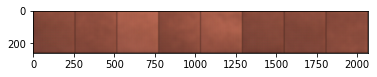

  0%|          | 0/10 [00:00<?, ?it/s]

real_score: 0.8505 fake_score: 0.2662 Loss_D: 0.6350 errVAE: 0.460967


  0%|          | 0/37 [00:00<?, ?it/s]

loss 0.8060 - acc@1 96.9388 - acc@5 98.6395 - val_loss 1.7202 - val_acc@1 78.6667 - val_acc@5 88.0000
Epoch [17/150]


  0%|          | 0/37 [00:00<?, ?it/s]

loss 0.8371 - acc@1 95.2381 - acc@5 96.9388 - val_loss 1.5495 - val_acc@1 92.0000 - val_acc@5 94.6667
Epoch [18/150]


  0%|          | 0/37 [00:00<?, ?it/s]

loss 0.8336 - acc@1 94.2177 - acc@5 97.2789 - val_loss 1.5320 - val_acc@1 90.6667 - val_acc@5 98.6667
Epoch [19/150]


  0%|          | 0/37 [00:00<?, ?it/s]

loss 0.8410 - acc@1 93.8776 - acc@5 97.2789 - val_loss 1.5477 - val_acc@1 86.6667 - val_acc@5 97.3333
Epoch [20/150]


  0%|          | 0/37 [00:00<?, ?it/s]

loss 0.8723 - acc@1 91.4966 - acc@5 96.9388 - val_loss 1.5863 - val_acc@1 88.0000 - val_acc@5 97.3333
Epoch [21/150]


100%|██████████| 37/37 [01:09<00:00,  1.87s/it]


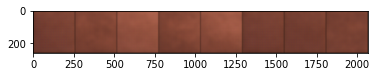

  0%|          | 0/10 [00:00<?, ?it/s]

real_score: 0.8776 fake_score: 0.3375 Loss_D: 0.8013 errVAE: 0.299673


  0%|          | 0/37 [00:00<?, ?it/s]

loss 0.8507 - acc@1 93.1973 - acc@5 96.9388 - val_loss 1.5944 - val_acc@1 82.6667 - val_acc@5 100.0000
Epoch [22/150]


  0%|          | 0/37 [00:00<?, ?it/s]

loss 0.8760 - acc@1 90.4762 - acc@5 97.2789 - val_loss 1.5720 - val_acc@1 81.3333 - val_acc@5 100.0000
Epoch [23/150]


  0%|          | 0/37 [00:00<?, ?it/s]

loss 0.8438 - acc@1 93.1973 - acc@5 97.2789 - val_loss 1.5578 - val_acc@1 85.3333 - val_acc@5 100.0000
Epoch [24/150]


  0%|          | 0/37 [00:00<?, ?it/s]

loss 0.8093 - acc@1 94.8980 - acc@5 98.2993 - val_loss 1.5485 - val_acc@1 86.6667 - val_acc@5 100.0000
Epoch [25/150]


  0%|          | 0/37 [00:00<?, ?it/s]

loss 0.7832 - acc@1 96.2585 - acc@5 98.2993 - val_loss 1.5456 - val_acc@1 88.0000 - val_acc@5 100.0000
Epoch [26/150]


100%|██████████| 37/37 [01:09<00:00,  1.87s/it]


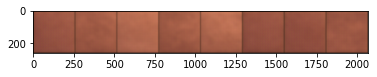

  0%|          | 0/10 [00:00<?, ?it/s]

real_score: 0.8758 fake_score: 0.2236 Loss_D: 0.6052 errVAE: 0.383740


  0%|          | 0/37 [00:00<?, ?it/s]

loss 0.7694 - acc@1 97.9592 - acc@5 98.6395 - val_loss 1.5580 - val_acc@1 86.6667 - val_acc@5 100.0000
Epoch [27/150]


  0%|          | 0/37 [00:00<?, ?it/s]

loss 0.8506 - acc@1 89.7959 - acc@5 97.6190 - val_loss 1.7012 - val_acc@1 82.6667 - val_acc@5 89.3333
Epoch [28/150]


  0%|          | 0/37 [00:00<?, ?it/s]

loss 0.8178 - acc@1 93.1973 - acc@5 98.9796 - val_loss 1.6163 - val_acc@1 80.0000 - val_acc@5 98.6667
Epoch [29/150]


  0%|          | 0/37 [00:00<?, ?it/s]

loss 0.7903 - acc@1 95.2381 - acc@5 99.3197 - val_loss 1.5564 - val_acc@1 81.3333 - val_acc@5 100.0000
Epoch [30/150]


  0%|          | 0/37 [00:00<?, ?it/s]

loss 0.7677 - acc@1 96.9388 - acc@5 99.3197 - val_loss 1.5584 - val_acc@1 84.0000 - val_acc@5 100.0000
Epoch [31/150]


100%|██████████| 37/37 [01:09<00:00,  1.88s/it]


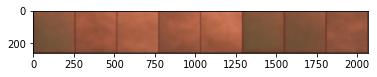

  0%|          | 0/10 [00:00<?, ?it/s]

real_score: 0.9163 fake_score: 0.1958 Loss_D: 0.5517 errVAE: 0.072462


  0%|          | 0/37 [00:00<?, ?it/s]

loss 0.7598 - acc@1 97.2789 - acc@5 99.3197 - val_loss 1.5648 - val_acc@1 84.0000 - val_acc@5 100.0000
Epoch [32/150]


100%|██████████| 10/10 [00:03<00:00,  2.60it/s]


loss 0.7970 - acc@1 94.2177 - acc@5 98.9796 - val_loss 1.4807 - val_acc@1 94.6667 - val_acc@5 100.0000


  0%|          | 0/37 [00:00<?, ?it/s]

=> saved best model
Epoch [33/150]


  0%|          | 0/37 [00:00<?, ?it/s]

loss 0.7909 - acc@1 94.5578 - acc@5 99.3197 - val_loss 1.6069 - val_acc@1 81.3333 - val_acc@5 100.0000
Epoch [34/150]


  0%|          | 0/37 [00:00<?, ?it/s]

loss 0.7737 - acc@1 95.5782 - acc@5 99.3197 - val_loss 1.5622 - val_acc@1 81.3333 - val_acc@5 100.0000
Epoch [35/150]


  0%|          | 0/37 [00:00<?, ?it/s]

loss 0.7536 - acc@1 97.2789 - acc@5 99.3197 - val_loss 1.5543 - val_acc@1 84.0000 - val_acc@5 100.0000
Epoch [36/150]


100%|██████████| 37/37 [01:09<00:00,  1.88s/it]


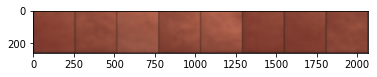

  0%|          | 0/10 [00:00<?, ?it/s]

real_score: 0.9043 fake_score: 0.1804 Loss_D: 0.5483 errVAE: 0.093951


  0%|          | 0/37 [00:00<?, ?it/s]

loss 0.7456 - acc@1 97.9592 - acc@5 99.3197 - val_loss 1.5562 - val_acc@1 84.0000 - val_acc@5 100.0000
Epoch [37/150]


  0%|          | 0/37 [00:00<?, ?it/s]

loss 0.7901 - acc@1 92.8571 - acc@5 99.6599 - val_loss 1.5621 - val_acc@1 85.3333 - val_acc@5 100.0000
Epoch [38/150]


  0%|          | 0/37 [00:00<?, ?it/s]

loss 0.7600 - acc@1 96.9388 - acc@5 99.3197 - val_loss 1.5399 - val_acc@1 85.3333 - val_acc@5 100.0000
Epoch [39/150]


  0%|          | 0/37 [00:00<?, ?it/s]

loss 0.7427 - acc@1 97.9592 - acc@5 99.3197 - val_loss 1.5513 - val_acc@1 84.0000 - val_acc@5 100.0000
Epoch [40/150]


  0%|          | 0/37 [00:00<?, ?it/s]

loss 0.7362 - acc@1 98.6395 - acc@5 99.3197 - val_loss 1.5539 - val_acc@1 84.0000 - val_acc@5 100.0000
Epoch [41/150]


100%|██████████| 37/37 [01:09<00:00,  1.88s/it]


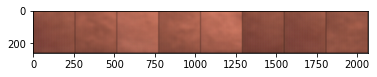

  0%|          | 0/10 [00:00<?, ?it/s]

real_score: 0.9260 fake_score: 0.1533 Loss_D: 0.4895 errVAE: 0.111485


  0%|          | 0/37 [00:00<?, ?it/s]

loss 0.7332 - acc@1 98.6395 - acc@5 99.3197 - val_loss 1.5564 - val_acc@1 84.0000 - val_acc@5 98.6667
Epoch [42/150]


  0%|          | 0/37 [00:00<?, ?it/s]

loss 0.7601 - acc@1 96.2585 - acc@5 99.6599 - val_loss 1.5018 - val_acc@1 90.6667 - val_acc@5 100.0000
Epoch [43/150]


  0%|          | 0/37 [00:00<?, ?it/s]

loss 0.7442 - acc@1 97.6190 - acc@5 99.6599 - val_loss 1.5605 - val_acc@1 84.0000 - val_acc@5 100.0000
Epoch [44/150]


  0%|          | 0/37 [00:00<?, ?it/s]

loss 0.7335 - acc@1 98.6395 - acc@5 99.6599 - val_loss 1.5243 - val_acc@1 89.3333 - val_acc@5 100.0000
Epoch [45/150]


  0%|          | 0/37 [00:00<?, ?it/s]

loss 0.7285 - acc@1 98.6395 - acc@5 99.6599 - val_loss 1.5205 - val_acc@1 88.0000 - val_acc@5 100.0000
Epoch [46/150]


100%|██████████| 37/37 [01:09<00:00,  1.88s/it]


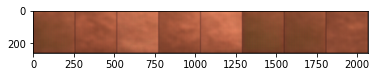

  0%|          | 0/10 [00:00<?, ?it/s]

real_score: 0.9238 fake_score: 0.1361 Loss_D: 0.4623 errVAE: 0.053007


  0%|          | 0/37 [00:00<?, ?it/s]

loss 0.7258 - acc@1 98.6395 - acc@5 99.6599 - val_loss 1.5469 - val_acc@1 84.0000 - val_acc@5 98.6667
Epoch [47/150]


  0%|          | 0/37 [00:00<?, ?it/s]

loss 0.7465 - acc@1 97.9592 - acc@5 99.6599 - val_loss 1.5123 - val_acc@1 89.3333 - val_acc@5 100.0000
Epoch [48/150]


  0%|          | 0/37 [00:00<?, ?it/s]

loss 0.7413 - acc@1 97.2789 - acc@5 99.6599 - val_loss 1.5756 - val_acc@1 82.6667 - val_acc@5 100.0000
Epoch [49/150]


  0%|          | 0/37 [00:00<?, ?it/s]

loss 0.7338 - acc@1 98.2993 - acc@5 99.6599 - val_loss 1.5412 - val_acc@1 85.3333 - val_acc@5 100.0000
Epoch [50/150]


  0%|          | 0/37 [00:00<?, ?it/s]

loss 0.7275 - acc@1 98.9796 - acc@5 99.6599 - val_loss 1.5600 - val_acc@1 82.6667 - val_acc@5 100.0000
Epoch [51/150]


100%|██████████| 37/37 [01:09<00:00,  1.87s/it]


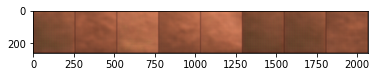

  0%|          | 0/10 [00:00<?, ?it/s]

real_score: 0.9283 fake_score: 0.1870 Loss_D: 0.5557 errVAE: 0.060922


  0%|          | 0/37 [00:00<?, ?it/s]

loss 0.7243 - acc@1 98.9796 - acc@5 99.6599 - val_loss 1.5574 - val_acc@1 82.6667 - val_acc@5 100.0000
Epoch [52/150]


  0%|          | 0/37 [00:00<?, ?it/s]

loss 0.7595 - acc@1 96.5986 - acc@5 100.0000 - val_loss 1.5155 - val_acc@1 90.6667 - val_acc@5 100.0000
Epoch [53/150]


  0%|          | 0/37 [00:00<?, ?it/s]

loss 0.7328 - acc@1 98.2993 - acc@5 100.0000 - val_loss 1.5281 - val_acc@1 88.0000 - val_acc@5 98.6667
Epoch [54/150]


  0%|          | 0/37 [00:00<?, ?it/s]

loss 0.7227 - acc@1 98.9796 - acc@5 99.6599 - val_loss 1.5362 - val_acc@1 85.3333 - val_acc@5 98.6667
Epoch [55/150]


  0%|          | 0/37 [00:00<?, ?it/s]

loss 0.7206 - acc@1 98.9796 - acc@5 100.0000 - val_loss 1.5306 - val_acc@1 86.6667 - val_acc@5 98.6667
Epoch [56/150]


100%|██████████| 37/37 [01:09<00:00,  1.88s/it]


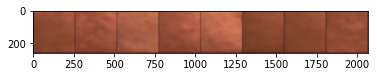

  0%|          | 0/10 [00:00<?, ?it/s]

real_score: 0.9155 fake_score: 0.1966 Loss_D: 0.5916 errVAE: 0.069268


  0%|          | 0/37 [00:00<?, ?it/s]

loss 0.7184 - acc@1 98.9796 - acc@5 100.0000 - val_loss 1.5333 - val_acc@1 86.6667 - val_acc@5 98.6667
Epoch [57/150]


100%|██████████| 10/10 [00:03<00:00,  2.59it/s]


loss 0.7375 - acc@1 97.9592 - acc@5 99.6599 - val_loss 1.4688 - val_acc@1 96.0000 - val_acc@5 100.0000


  0%|          | 0/37 [00:00<?, ?it/s]

=> saved best model
Epoch [58/150]


  0%|          | 0/37 [00:00<?, ?it/s]

loss 0.7195 - acc@1 98.9796 - acc@5 100.0000 - val_loss 1.5246 - val_acc@1 86.6667 - val_acc@5 100.0000
Epoch [59/150]


  0%|          | 0/37 [00:00<?, ?it/s]

loss 0.7181 - acc@1 98.9796 - acc@5 100.0000 - val_loss 1.5207 - val_acc@1 88.0000 - val_acc@5 98.6667
Epoch [60/150]


  0%|          | 0/37 [00:00<?, ?it/s]

loss 0.7170 - acc@1 98.9796 - acc@5 100.0000 - val_loss 1.5347 - val_acc@1 84.0000 - val_acc@5 98.6667
Epoch [61/150]


100%|██████████| 37/37 [01:09<00:00,  1.88s/it]


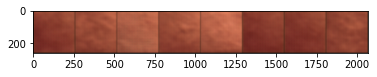

  0%|          | 0/10 [00:00<?, ?it/s]

real_score: 0.9347 fake_score: 0.2130 Loss_D: 0.5792 errVAE: 0.044911


  0%|          | 0/37 [00:00<?, ?it/s]

loss 0.7158 - acc@1 98.9796 - acc@5 100.0000 - val_loss 1.5271 - val_acc@1 85.3333 - val_acc@5 98.6667
Epoch [62/150]


  0%|          | 0/37 [00:00<?, ?it/s]

loss 0.7298 - acc@1 98.2993 - acc@5 99.6599 - val_loss 1.4721 - val_acc@1 96.0000 - val_acc@5 98.6667
Epoch [63/150]


  0%|          | 0/37 [00:00<?, ?it/s]

loss 0.7147 - acc@1 98.9796 - acc@5 100.0000 - val_loss 1.5093 - val_acc@1 90.6667 - val_acc@5 100.0000
Epoch [64/150]


  0%|          | 0/37 [00:00<?, ?it/s]

loss 0.7150 - acc@1 98.9796 - acc@5 100.0000 - val_loss 1.5216 - val_acc@1 88.0000 - val_acc@5 98.6667
Epoch [65/150]


  0%|          | 0/37 [00:00<?, ?it/s]

loss 0.7144 - acc@1 98.9796 - acc@5 100.0000 - val_loss 1.5307 - val_acc@1 84.0000 - val_acc@5 98.6667
Epoch [66/150]


100%|██████████| 37/37 [01:09<00:00,  1.88s/it]


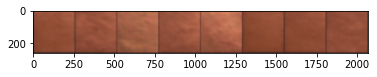

  0%|          | 0/10 [00:00<?, ?it/s]

real_score: 0.9266 fake_score: 0.2630 Loss_D: 0.6520 errVAE: 0.062393


  0%|          | 0/37 [00:00<?, ?it/s]

loss 0.7138 - acc@1 98.9796 - acc@5 100.0000 - val_loss 1.5268 - val_acc@1 85.3333 - val_acc@5 98.6667
Epoch [67/150]


  0%|          | 0/37 [00:00<?, ?it/s]

loss 0.7272 - acc@1 98.2993 - acc@5 99.6599 - val_loss 1.4724 - val_acc@1 96.0000 - val_acc@5 98.6667
Epoch [68/150]


  0%|          | 0/37 [00:00<?, ?it/s]

loss 0.7126 - acc@1 98.9796 - acc@5 100.0000 - val_loss 1.5080 - val_acc@1 93.3333 - val_acc@5 100.0000
Epoch [69/150]


  0%|          | 0/37 [00:00<?, ?it/s]

loss 0.7136 - acc@1 98.9796 - acc@5 100.0000 - val_loss 1.5198 - val_acc@1 89.3333 - val_acc@5 98.6667
Epoch [70/150]


  0%|          | 0/37 [00:00<?, ?it/s]

loss 0.7131 - acc@1 98.9796 - acc@5 100.0000 - val_loss 1.5283 - val_acc@1 84.0000 - val_acc@5 98.6667
Epoch [71/150]


100%|██████████| 37/37 [01:09<00:00,  1.88s/it]


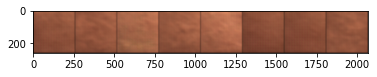

  0%|          | 0/10 [00:00<?, ?it/s]

real_score: 0.9291 fake_score: 0.2121 Loss_D: 0.5875 errVAE: 0.044969


  0%|          | 0/37 [00:00<?, ?it/s]

loss 0.7126 - acc@1 98.9796 - acc@5 100.0000 - val_loss 1.5265 - val_acc@1 85.3333 - val_acc@5 98.6667
Epoch [72/150]


  0%|          | 0/37 [00:00<?, ?it/s]

loss 0.7256 - acc@1 98.2993 - acc@5 99.6599 - val_loss 1.4708 - val_acc@1 96.0000 - val_acc@5 98.6667
Epoch [73/150]


  0%|          | 0/37 [00:00<?, ?it/s]

loss 0.7114 - acc@1 98.9796 - acc@5 100.0000 - val_loss 1.5090 - val_acc@1 89.3333 - val_acc@5 100.0000
Epoch [74/150]


  0%|          | 0/37 [00:00<?, ?it/s]

loss 0.7124 - acc@1 98.9796 - acc@5 100.0000 - val_loss 1.5282 - val_acc@1 85.3333 - val_acc@5 98.6667
Epoch [75/150]


  0%|          | 0/37 [00:00<?, ?it/s]

loss 0.7120 - acc@1 98.9796 - acc@5 100.0000 - val_loss 1.5276 - val_acc@1 84.0000 - val_acc@5 98.6667
Epoch [76/150]


100%|██████████| 37/37 [01:09<00:00,  1.88s/it]


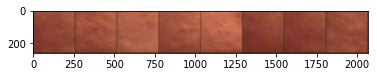

  0%|          | 0/10 [00:00<?, ?it/s]

real_score: 0.8856 fake_score: 0.2352 Loss_D: 0.7305 errVAE: 0.048770


  0%|          | 0/37 [00:00<?, ?it/s]

loss 0.7117 - acc@1 98.9796 - acc@5 100.0000 - val_loss 1.5288 - val_acc@1 85.3333 - val_acc@5 98.6667
Epoch [77/150]


  0%|          | 0/37 [00:00<?, ?it/s]

loss 0.7242 - acc@1 98.2993 - acc@5 99.6599 - val_loss 1.4697 - val_acc@1 96.0000 - val_acc@5 98.6667
Epoch [78/150]


  0%|          | 0/37 [00:00<?, ?it/s]

loss 0.7109 - acc@1 98.9796 - acc@5 100.0000 - val_loss 1.5154 - val_acc@1 88.0000 - val_acc@5 98.6667
Epoch [79/150]


  0%|          | 0/37 [00:00<?, ?it/s]

loss 0.7116 - acc@1 98.9796 - acc@5 100.0000 - val_loss 1.5301 - val_acc@1 85.3333 - val_acc@5 98.6667
Epoch [80/150]


  0%|          | 0/37 [00:00<?, ?it/s]

loss 0.7113 - acc@1 98.9796 - acc@5 100.0000 - val_loss 1.5291 - val_acc@1 84.0000 - val_acc@5 98.6667
Epoch [81/150]


100%|██████████| 37/37 [01:09<00:00,  1.88s/it]


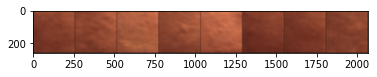

  0%|          | 0/10 [00:00<?, ?it/s]

real_score: 0.9297 fake_score: 0.1797 Loss_D: 0.5153 errVAE: 0.050809


  0%|          | 0/37 [00:00<?, ?it/s]

loss 0.7111 - acc@1 98.9796 - acc@5 100.0000 - val_loss 1.5299 - val_acc@1 85.3333 - val_acc@5 98.6667
Epoch [82/150]


100%|██████████| 10/10 [00:03<00:00,  2.61it/s]


loss 0.7230 - acc@1 98.2993 - acc@5 99.6599 - val_loss 1.4686 - val_acc@1 96.0000 - val_acc@5 98.6667


  0%|          | 0/37 [00:00<?, ?it/s]

=> saved best model
Epoch [83/150]


  0%|          | 0/37 [00:00<?, ?it/s]

loss 0.7105 - acc@1 98.9796 - acc@5 100.0000 - val_loss 1.5211 - val_acc@1 85.3333 - val_acc@5 98.6667
Epoch [84/150]


  0%|          | 0/37 [00:00<?, ?it/s]

loss 0.7109 - acc@1 98.9796 - acc@5 100.0000 - val_loss 1.5314 - val_acc@1 84.0000 - val_acc@5 98.6667
Epoch [85/150]


  0%|          | 0/37 [00:00<?, ?it/s]

loss 0.7108 - acc@1 98.9796 - acc@5 100.0000 - val_loss 1.5307 - val_acc@1 84.0000 - val_acc@5 98.6667
Epoch [86/150]


100%|██████████| 37/37 [01:09<00:00,  1.88s/it]


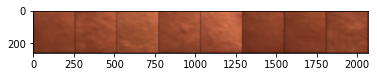

  0%|          | 0/10 [00:00<?, ?it/s]

real_score: 0.9437 fake_score: 0.2748 Loss_D: 0.6576 errVAE: 0.067229


  0%|          | 0/37 [00:00<?, ?it/s]

loss 0.7106 - acc@1 98.9796 - acc@5 100.0000 - val_loss 1.5311 - val_acc@1 84.0000 - val_acc@5 98.6667
Epoch [87/150]


100%|██████████| 10/10 [00:03<00:00,  2.58it/s]


loss 0.7220 - acc@1 98.2993 - acc@5 100.0000 - val_loss 1.4681 - val_acc@1 96.0000 - val_acc@5 98.6667


  0%|          | 0/37 [00:00<?, ?it/s]

=> saved best model
Epoch [88/150]


  0%|          | 0/37 [00:00<?, ?it/s]

loss 0.7102 - acc@1 98.9796 - acc@5 100.0000 - val_loss 1.5247 - val_acc@1 85.3333 - val_acc@5 98.6667
Epoch [89/150]


  0%|          | 0/37 [00:00<?, ?it/s]

loss 0.7105 - acc@1 98.9796 - acc@5 100.0000 - val_loss 1.5326 - val_acc@1 84.0000 - val_acc@5 98.6667
Epoch [90/150]


  0%|          | 0/37 [00:00<?, ?it/s]

loss 0.7105 - acc@1 98.9796 - acc@5 100.0000 - val_loss 1.5320 - val_acc@1 84.0000 - val_acc@5 98.6667
Epoch [91/150]


100%|██████████| 37/37 [01:09<00:00,  1.88s/it]


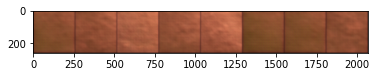

  0%|          | 0/10 [00:00<?, ?it/s]

real_score: 0.9415 fake_score: 0.2070 Loss_D: 0.5548 errVAE: 0.045711


  0%|          | 0/37 [00:00<?, ?it/s]

loss 0.7103 - acc@1 98.9796 - acc@5 100.0000 - val_loss 1.5324 - val_acc@1 84.0000 - val_acc@5 98.6667
Epoch [92/150]


100%|██████████| 10/10 [00:03<00:00,  2.61it/s]


loss 0.7214 - acc@1 98.2993 - acc@5 100.0000 - val_loss 1.4677 - val_acc@1 96.0000 - val_acc@5 98.6667


  0%|          | 0/37 [00:00<?, ?it/s]

=> saved best model
Epoch [93/150]


  0%|          | 0/37 [00:00<?, ?it/s]

loss 0.7100 - acc@1 98.9796 - acc@5 100.0000 - val_loss 1.5271 - val_acc@1 85.3333 - val_acc@5 98.6667
Epoch [94/150]


  0%|          | 0/37 [00:00<?, ?it/s]

loss 0.7102 - acc@1 98.9796 - acc@5 100.0000 - val_loss 1.5339 - val_acc@1 84.0000 - val_acc@5 98.6667
Epoch [95/150]


  0%|          | 0/37 [00:00<?, ?it/s]

loss 0.7101 - acc@1 98.9796 - acc@5 100.0000 - val_loss 1.5331 - val_acc@1 84.0000 - val_acc@5 98.6667
Epoch [96/150]


100%|██████████| 37/37 [01:09<00:00,  1.88s/it]


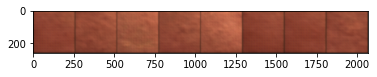

  0%|          | 0/10 [00:00<?, ?it/s]

real_score: 0.9504 fake_score: 0.2862 Loss_D: 0.6934 errVAE: 0.045937


  0%|          | 0/37 [00:00<?, ?it/s]

loss 0.7100 - acc@1 98.9796 - acc@5 100.0000 - val_loss 1.5336 - val_acc@1 84.0000 - val_acc@5 98.6667
Epoch [97/150]


100%|██████████| 10/10 [00:03<00:00,  2.55it/s]


loss 0.7209 - acc@1 98.2993 - acc@5 100.0000 - val_loss 1.4674 - val_acc@1 96.0000 - val_acc@5 98.6667


  0%|          | 0/37 [00:00<?, ?it/s]

=> saved best model
Epoch [98/150]


  0%|          | 0/37 [00:00<?, ?it/s]

loss 0.7098 - acc@1 98.9796 - acc@5 100.0000 - val_loss 1.5291 - val_acc@1 84.0000 - val_acc@5 98.6667
Epoch [99/150]


  0%|          | 0/37 [00:00<?, ?it/s]

loss 0.7099 - acc@1 98.9796 - acc@5 100.0000 - val_loss 1.5350 - val_acc@1 82.6667 - val_acc@5 98.6667
Epoch [100/150]


  0%|          | 0/37 [00:00<?, ?it/s]

loss 0.7099 - acc@1 98.9796 - acc@5 100.0000 - val_loss 1.5341 - val_acc@1 84.0000 - val_acc@5 98.6667
Epoch [101/150]


100%|██████████| 37/37 [01:09<00:00,  1.88s/it]


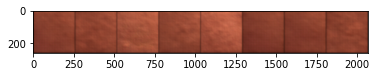

  0%|          | 0/10 [00:00<?, ?it/s]

real_score: 0.9372 fake_score: 0.2051 Loss_D: 0.5503 errVAE: 0.052773


  0%|          | 0/37 [00:00<?, ?it/s]

loss 0.7098 - acc@1 98.9796 - acc@5 100.0000 - val_loss 1.5347 - val_acc@1 82.6667 - val_acc@5 98.6667
Epoch [102/150]


100%|██████████| 10/10 [00:03<00:00,  2.58it/s]


loss 0.7204 - acc@1 98.2993 - acc@5 100.0000 - val_loss 1.4671 - val_acc@1 96.0000 - val_acc@5 100.0000


  0%|          | 0/37 [00:00<?, ?it/s]

=> saved best model
Epoch [103/150]


  0%|          | 0/37 [00:00<?, ?it/s]

loss 0.7096 - acc@1 98.9796 - acc@5 100.0000 - val_loss 1.5309 - val_acc@1 84.0000 - val_acc@5 98.6667
Epoch [104/150]


  0%|          | 0/37 [00:00<?, ?it/s]

loss 0.7097 - acc@1 98.9796 - acc@5 100.0000 - val_loss 1.5357 - val_acc@1 82.6667 - val_acc@5 98.6667
Epoch [105/150]


  0%|          | 0/37 [00:00<?, ?it/s]

loss 0.7097 - acc@1 98.9796 - acc@5 100.0000 - val_loss 1.5350 - val_acc@1 82.6667 - val_acc@5 98.6667
Epoch [106/150]


100%|██████████| 37/37 [01:09<00:00,  1.88s/it]


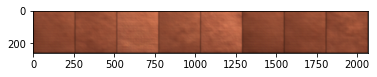

  0%|          | 0/10 [00:00<?, ?it/s]

real_score: 0.9407 fake_score: 0.1866 Loss_D: 0.5256 errVAE: 0.082701


  0%|          | 0/37 [00:00<?, ?it/s]

loss 0.7097 - acc@1 98.9796 - acc@5 100.0000 - val_loss 1.5355 - val_acc@1 82.6667 - val_acc@5 98.6667
Epoch [107/150]


100%|██████████| 10/10 [00:03<00:00,  2.58it/s]


loss 0.7201 - acc@1 98.2993 - acc@5 100.0000 - val_loss 1.4669 - val_acc@1 96.0000 - val_acc@5 100.0000


  0%|          | 0/37 [00:00<?, ?it/s]

=> saved best model
Epoch [108/150]


  0%|          | 0/37 [00:00<?, ?it/s]

loss 0.7095 - acc@1 98.9796 - acc@5 100.0000 - val_loss 1.5324 - val_acc@1 84.0000 - val_acc@5 98.6667
Epoch [109/150]


  0%|          | 0/37 [00:00<?, ?it/s]

loss 0.7096 - acc@1 98.9796 - acc@5 100.0000 - val_loss 1.5362 - val_acc@1 82.6667 - val_acc@5 98.6667
Epoch [110/150]


  0%|          | 0/37 [00:00<?, ?it/s]

loss 0.7095 - acc@1 98.9796 - acc@5 100.0000 - val_loss 1.5358 - val_acc@1 82.6667 - val_acc@5 98.6667
Epoch [111/150]


100%|██████████| 37/37 [01:09<00:00,  1.88s/it]


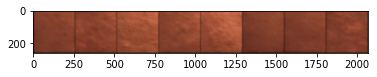

  0%|          | 0/10 [00:00<?, ?it/s]

real_score: 0.9063 fake_score: 0.1497 Loss_D: 0.5237 errVAE: 0.041092


  0%|          | 0/37 [00:00<?, ?it/s]

loss 0.7096 - acc@1 98.9796 - acc@5 100.0000 - val_loss 1.5362 - val_acc@1 82.6667 - val_acc@5 98.6667
Epoch [112/150]


100%|██████████| 10/10 [00:03<00:00,  2.58it/s]


loss 0.7198 - acc@1 98.2993 - acc@5 100.0000 - val_loss 1.4669 - val_acc@1 96.0000 - val_acc@5 100.0000


  0%|          | 0/37 [00:00<?, ?it/s]

=> saved best model
Epoch [113/150]


  0%|          | 0/37 [00:00<?, ?it/s]

loss 0.7094 - acc@1 98.9796 - acc@5 100.0000 - val_loss 1.5336 - val_acc@1 84.0000 - val_acc@5 98.6667
Epoch [114/150]


  0%|          | 0/37 [00:00<?, ?it/s]

loss 0.7095 - acc@1 98.9796 - acc@5 100.0000 - val_loss 1.5366 - val_acc@1 82.6667 - val_acc@5 98.6667
Epoch [115/150]


  0%|          | 0/37 [00:00<?, ?it/s]

loss 0.7095 - acc@1 98.9796 - acc@5 100.0000 - val_loss 1.5365 - val_acc@1 82.6667 - val_acc@5 98.6667
Epoch [116/150]


100%|██████████| 37/37 [01:09<00:00,  1.88s/it]


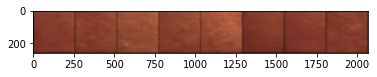

  0%|          | 0/10 [00:00<?, ?it/s]

real_score: 0.9459 fake_score: 0.1452 Loss_D: 0.4730 errVAE: 0.054413


  0%|          | 0/37 [00:00<?, ?it/s]

loss 0.7095 - acc@1 98.9796 - acc@5 100.0000 - val_loss 1.5367 - val_acc@1 82.6667 - val_acc@5 98.6667
Epoch [117/150]


100%|██████████| 10/10 [00:03<00:00,  2.54it/s]


loss 0.7196 - acc@1 98.2993 - acc@5 100.0000 - val_loss 1.4668 - val_acc@1 96.0000 - val_acc@5 100.0000


  0%|          | 0/37 [00:00<?, ?it/s]

=> saved best model
Epoch [118/150]


  0%|          | 0/37 [00:00<?, ?it/s]

loss 0.7093 - acc@1 98.9796 - acc@5 100.0000 - val_loss 1.5348 - val_acc@1 84.0000 - val_acc@5 98.6667
Epoch [119/150]


  0%|          | 0/37 [00:00<?, ?it/s]

loss 0.7094 - acc@1 98.9796 - acc@5 100.0000 - val_loss 1.5368 - val_acc@1 82.6667 - val_acc@5 98.6667
Epoch [120/150]


  0%|          | 0/37 [00:00<?, ?it/s]

loss 0.7094 - acc@1 98.9796 - acc@5 100.0000 - val_loss 1.5370 - val_acc@1 82.6667 - val_acc@5 98.6667
Epoch [121/150]


100%|██████████| 37/37 [01:09<00:00,  1.88s/it]


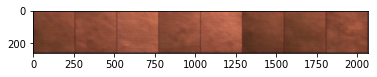

  0%|          | 0/10 [00:00<?, ?it/s]

real_score: 0.9430 fake_score: 0.1662 Loss_D: 0.5064 errVAE: 0.084176


  0%|          | 0/37 [00:00<?, ?it/s]

loss 0.7094 - acc@1 98.9796 - acc@5 100.0000 - val_loss 1.5371 - val_acc@1 82.6667 - val_acc@5 98.6667
Epoch [122/150]


100%|██████████| 10/10 [00:03<00:00,  2.56it/s]


loss 0.7194 - acc@1 98.2993 - acc@5 100.0000 - val_loss 1.4668 - val_acc@1 96.0000 - val_acc@5 100.0000


  0%|          | 0/37 [00:00<?, ?it/s]

=> saved best model
Epoch [123/150]


  0%|          | 0/37 [00:00<?, ?it/s]

loss 0.7093 - acc@1 98.9796 - acc@5 100.0000 - val_loss 1.5358 - val_acc@1 82.6667 - val_acc@5 98.6667
Epoch [124/150]


  0%|          | 0/37 [00:00<?, ?it/s]

loss 0.7094 - acc@1 98.9796 - acc@5 100.0000 - val_loss 1.5370 - val_acc@1 82.6667 - val_acc@5 98.6667
Epoch [125/150]


  0%|          | 0/37 [00:00<?, ?it/s]

loss 0.7094 - acc@1 98.9796 - acc@5 100.0000 - val_loss 1.5373 - val_acc@1 82.6667 - val_acc@5 98.6667
Epoch [126/150]


100%|██████████| 37/37 [01:09<00:00,  1.88s/it]


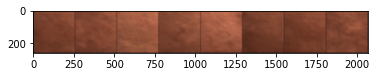

  0%|          | 0/10 [00:00<?, ?it/s]

real_score: 0.9430 fake_score: 0.2319 Loss_D: 0.5831 errVAE: 0.037265


  0%|          | 0/37 [00:00<?, ?it/s]

loss 0.7093 - acc@1 98.9796 - acc@5 100.0000 - val_loss 1.5374 - val_acc@1 82.6667 - val_acc@5 98.6667
Epoch [127/150]


100%|██████████| 10/10 [00:03<00:00,  2.61it/s]


loss 0.7193 - acc@1 98.2993 - acc@5 100.0000 - val_loss 1.4667 - val_acc@1 96.0000 - val_acc@5 100.0000


  0%|          | 0/37 [00:00<?, ?it/s]

=> saved best model
Epoch [128/150]


  0%|          | 0/37 [00:00<?, ?it/s]

loss 0.7092 - acc@1 98.9796 - acc@5 100.0000 - val_loss 1.5366 - val_acc@1 82.6667 - val_acc@5 98.6667
Epoch [129/150]


  0%|          | 0/37 [00:00<?, ?it/s]

loss 0.7093 - acc@1 98.9796 - acc@5 100.0000 - val_loss 1.5372 - val_acc@1 82.6667 - val_acc@5 98.6667
Epoch [130/150]


  0%|          | 0/37 [00:00<?, ?it/s]

loss 0.7093 - acc@1 98.9796 - acc@5 100.0000 - val_loss 1.5375 - val_acc@1 82.6667 - val_acc@5 98.6667
Epoch [131/150]


100%|██████████| 37/37 [01:09<00:00,  1.88s/it]


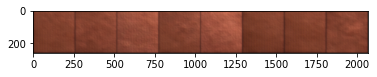

  0%|          | 0/10 [00:00<?, ?it/s]

real_score: 0.9448 fake_score: 0.2510 Loss_D: 0.7521 errVAE: 0.042388


  0%|          | 0/37 [00:00<?, ?it/s]

loss 0.7093 - acc@1 98.9796 - acc@5 100.0000 - val_loss 1.5376 - val_acc@1 82.6667 - val_acc@5 98.6667
Epoch [132/150]


100%|██████████| 10/10 [00:03<00:00,  2.57it/s]


loss 0.7192 - acc@1 98.2993 - acc@5 100.0000 - val_loss 1.4667 - val_acc@1 96.0000 - val_acc@5 100.0000


  0%|          | 0/37 [00:00<?, ?it/s]

=> saved best model
Epoch [133/150]


  0%|          | 0/37 [00:00<?, ?it/s]

loss 0.7092 - acc@1 98.9796 - acc@5 100.0000 - val_loss 1.5371 - val_acc@1 82.6667 - val_acc@5 98.6667
Epoch [134/150]


  0%|          | 0/37 [00:00<?, ?it/s]

loss 0.7093 - acc@1 98.9796 - acc@5 100.0000 - val_loss 1.5374 - val_acc@1 82.6667 - val_acc@5 98.6667
Epoch [135/150]


  0%|          | 0/37 [00:00<?, ?it/s]

loss 0.7093 - acc@1 98.9796 - acc@5 100.0000 - val_loss 1.5376 - val_acc@1 82.6667 - val_acc@5 98.6667
Epoch [136/150]


100%|██████████| 37/37 [01:09<00:00,  1.88s/it]


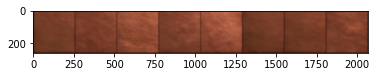

  0%|          | 0/10 [00:00<?, ?it/s]

real_score: 0.9338 fake_score: 0.2439 Loss_D: 0.6433 errVAE: 0.041649


  0%|          | 0/37 [00:00<?, ?it/s]

loss 0.7093 - acc@1 98.9796 - acc@5 100.0000 - val_loss 1.5377 - val_acc@1 82.6667 - val_acc@5 98.6667
Epoch [137/150]


100%|██████████| 10/10 [00:03<00:00,  2.56it/s]


loss 0.7191 - acc@1 98.2993 - acc@5 100.0000 - val_loss 1.4667 - val_acc@1 96.0000 - val_acc@5 100.0000


  0%|          | 0/37 [00:00<?, ?it/s]

=> saved best model
Epoch [138/150]


  0%|          | 0/37 [00:00<?, ?it/s]

loss 0.7092 - acc@1 98.9796 - acc@5 100.0000 - val_loss 1.5375 - val_acc@1 82.6667 - val_acc@5 98.6667
Epoch [139/150]


  0%|          | 0/37 [00:00<?, ?it/s]

loss 0.7092 - acc@1 98.9796 - acc@5 100.0000 - val_loss 1.5376 - val_acc@1 82.6667 - val_acc@5 98.6667
Epoch [140/150]


  0%|          | 0/37 [00:00<?, ?it/s]

loss 0.7092 - acc@1 98.9796 - acc@5 100.0000 - val_loss 1.5377 - val_acc@1 82.6667 - val_acc@5 98.6667
Epoch [141/150]


100%|██████████| 37/37 [01:09<00:00,  1.88s/it]


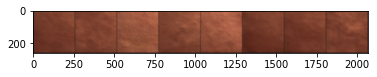

  0%|          | 0/10 [00:00<?, ?it/s]

real_score: 0.9392 fake_score: 0.1579 Loss_D: 0.5193 errVAE: 0.040956


  0%|          | 0/37 [00:00<?, ?it/s]

loss 0.7092 - acc@1 98.9796 - acc@5 100.0000 - val_loss 1.5378 - val_acc@1 82.6667 - val_acc@5 98.6667
Epoch [142/150]


100%|██████████| 10/10 [00:03<00:00,  2.57it/s]


loss 0.7191 - acc@1 98.2993 - acc@5 100.0000 - val_loss 1.4667 - val_acc@1 96.0000 - val_acc@5 100.0000


  0%|          | 0/37 [00:00<?, ?it/s]

=> saved best model
Epoch [143/150]


  0%|          | 0/37 [00:00<?, ?it/s]

loss 0.7092 - acc@1 98.9796 - acc@5 100.0000 - val_loss 1.5376 - val_acc@1 82.6667 - val_acc@5 98.6667
Epoch [144/150]


  0%|          | 0/37 [00:00<?, ?it/s]

loss 0.7092 - acc@1 98.9796 - acc@5 100.0000 - val_loss 1.5377 - val_acc@1 82.6667 - val_acc@5 98.6667
Epoch [145/150]


  0%|          | 0/37 [00:00<?, ?it/s]

loss 0.7092 - acc@1 98.9796 - acc@5 100.0000 - val_loss 1.5378 - val_acc@1 82.6667 - val_acc@5 98.6667
Epoch [146/150]


100%|██████████| 37/37 [01:09<00:00,  1.88s/it]


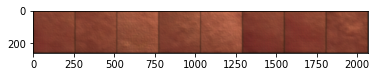

  0%|          | 0/10 [00:00<?, ?it/s]

real_score: 0.8952 fake_score: 0.1767 Loss_D: 0.6088 errVAE: 0.128235


  0%|          | 0/37 [00:00<?, ?it/s]

loss 0.7092 - acc@1 98.9796 - acc@5 100.0000 - val_loss 1.5378 - val_acc@1 82.6667 - val_acc@5 98.6667
Epoch [147/150]


  0%|          | 0/37 [00:00<?, ?it/s]

loss 0.7191 - acc@1 98.2993 - acc@5 100.0000 - val_loss 1.4667 - val_acc@1 96.0000 - val_acc@5 100.0000
Epoch [148/150]


  0%|          | 0/37 [00:00<?, ?it/s]

loss 0.7092 - acc@1 98.9796 - acc@5 100.0000 - val_loss 1.5377 - val_acc@1 82.6667 - val_acc@5 98.6667
Epoch [149/150]


  0%|          | 0/37 [00:00<?, ?it/s]

loss 0.7092 - acc@1 98.9796 - acc@5 100.0000 - val_loss 1.5378 - val_acc@1 82.6667 - val_acc@5 98.6667
Epoch [150/150]


100%|██████████| 10/10 [00:03<00:00,  2.57it/s]


loss 0.7092 - acc@1 98.9796 - acc@5 100.0000 - val_loss 1.5378 - val_acc@1 82.6667 - val_acc@5 98.6667


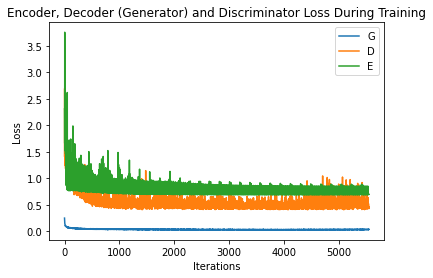

In [ ]:
optimizer = optim.SGD(filter(lambda p: p.requires_grad, resN.parameters()), lr=args.lr,
                          momentum=args.momentum, weight_decay=args.weight_decay)

scheduler = lr_scheduler.CosineAnnealingLR(optimizer,
                                            T_max=args.epochs, eta_min=args.min_lr)

log = pd.DataFrame(index=[], columns=[
      'epoch', 'lr', 'loss', 'acc@1', 'acc@5', 'val_loss', 'val_acc1', 'val_acc5'
    ])

best_loss = float('inf')

D_Losses = []
G_Losses = []
E_Losses = []

for epoch in range(args.epochs):
    print('Epoch [%d/%d]' % (epoch + 1, args.epochs))

    scheduler.step()

    # train for one epoch
    train_log = train(args, train_loader, resN, model,D, metric_fc, criterion, optimizer, epoch)
    # evaluate on validation set
    val_log = validate(args, test_loader,resN, model, metric_fc, criterion)

    print('loss %.4f - acc@1 %.4f - acc@5 %.4f - val_loss %.4f - val_acc@1 %.4f - val_acc@5 %.4f'
            %(train_log['loss'], train_log['acc@1'], train_log['acc@5'], val_log['loss'], val_log['acc@1'], val_log['acc@5']))

    tmp = pd.Series([
            epoch,
            scheduler.get_lr()[0],
            train_log['loss'],
            train_log['acc@1'],
            train_log['acc@5'],
            val_log['loss'],
            val_log['acc@1'],
            val_log['acc@5'],
        ], index=['epoch', 'lr', 'loss', 'acc@1', 'acc@5', 'val_loss', 'val_acc1', 'val_acc5'])

    log = log.append(tmp, ignore_index=True)

    if val_log['loss'] < best_loss:
        torch.save(model.state_dict(), '/content/drive/My Drive/Research_project/saved_models/vae_model_best.pt')
        torch.save(D.state_dict(), '/content/drive/My Drive/Research_project/saved_models/D_model_best.pt')
        torch.save(metric_fc.state_dict(), '/content/drive/My Drive/Research_project/saved_models/metric_best.pt')
        best_loss = val_log['loss']
        print("=> saved best model")

plt.title("Encoder, Decoder (Generator) and Discriminator Loss During Training")
plt.plot(G_Losses, label = "G")
plt.plot(D_Losses, label = "D")
plt.plot(E_Losses, label = "E")
plt.xlabel("Iterations")
plt.ylabel("Loss")
plt.legend()
plt.show()

In [ ]:
model.load_state_dict(torch.load('/content/drive/My Drive/Research_project/saved_models/vae_model_best.pt'))
metric_fc.load_state_dict(torch.load('/content/drive/My Drive/Research_project/saved_models/metric_best.pt'))

<All keys matched successfully>

In [ ]:
def plot_tSNE(X, y):
  plt.figure(figsize=(8, 6))
      
  # clean the figure
  plt.clf()

  tsne = TSNE()
  X_embedded = tsne.fit_transform(X)
  cmap = ['#00FFFF','#DEB887', '#B8860B','#ffa58f','#ff5f24']
  for idx in range(5):
    plt.scatter(X_embedded[(y==idx), 0], X_embedded[(y==idx), 1], c=cmap[idx], label=idx)

  plt.legend(mvtec_classes, ncol=5, bbox_to_anchor=(1.05, 1), loc='upper left')
  plt.xticks(())
  plt.yticks(())

  plt.show()     

In [ ]:
def plot_tSNE_MVtec(model, metric_fc, train_loader):
  with torch.no_grad():
    model = model.cpu()
    metric_fc = metric_fc.cpu()
    _i = 0
    model.eval()
    for ii, data in enumerate(train_loader):
        _i = _i + 1
        #print(_i)
        data_input, label = data
        
        feature = model(data_input)
        ctgr = metric_fc(feature)
        ctgr = ctgr.argmax(dim=1)
        if _i == 1:
            plt_arc_x = feature
            plt_arc_y = label
            plt_arc_ctgr = ctgr
        else:
            plt_arc_x = torch.cat([plt_arc_x, feature], dim=0)
            plt_arc_y = torch.cat([plt_arc_y, label], dim=0)
            plt_arc_ctgr = torch.cat([plt_arc_ctgr, ctgr], dim=0)

    X = plt_arc_x.cpu().detach().numpy() 
    y = plt_arc_y.cpu().detach().numpy()
    plot_tSNE(X, y)

    plt_arc_df = pd.DataFrame({'label': plt_arc_y})
    plt_arc_df['ctgr'] = plt_arc_ctgr

    X_train=X
    y_train=y
    return X, y, plt_arc_df

In [ ]:
mvtec_classes = []
for i in range(5):
    mvtec_classes.append(str(i))

X_train, y_train, plt_arc_df_train = plot_tSNE_MVtec(resN, metric_fc, train_loader)
X_test, y_test, plt_arc_df_test = plot_tSNE_MVtec(resN, metric_fc, test_loader)
X = np.concatenate([X_train, X_test])
y = np.concatenate([y_train, y_test])
plot_tSNE(X, y)

KeyboardInterrupt: ignored

In [ ]:
def conv3x3(in_planes, out_planes, stride=1, groups=1, dilation=1):
    """3x3 convolution with padding"""
    return nn.Conv2d(in_planes, out_planes, kernel_size=3, stride=stride,
                     padding=dilation, groups=groups, bias=False, dilation=dilation)

def conv1x1(in_planes, out_planes, stride=1):
    """1x1 convolution"""
    return nn.Conv2d(in_planes, out_planes, kernel_size=1, stride=stride, bias=False)

In [ ]:
class My_BasicBlock(nn.Module):
    expansion = 1
    med_out = None
    def __init__(self, inplanes, planes, stride=1, downsample=None, groups=1,
                 base_width=64, dilation=1, norm_layer=None):
        super(My_BasicBlock, self).__init__()
        if norm_layer is None:
            norm_layer = nn.BatchNorm2d
        width = int(planes * (base_width / 64.)) * groups
        # Both self.conv2 and self.downsample layers downsample the input when stride != 1
        self.conv1 = conv3x3(inplanes, width, stride, groups, dilation)
        self.bn1 = norm_layer(width)
        self.relu = nn.ReLU(inplace=True)
        self.conv2 = conv3x3(width, width, stride, groups, dilation)
        self.bn2 = norm_layer(width)
        self.downsample = downsample
        self.stride = stride

    def forward(self, x):
        identity = x

        out = self.conv1(x)
        out = self.bn1(out)
        out = self.relu(out)

        out = self.conv2(out)
        My_BasicBlock.med_out = out
        out = self.bn2(out)

        if self.downsample is not None:
            identity = self.downsample(x)

        out += identity
        out = self.relu(out)

        return out
      
    @classmethod
    def get_med_out(cls):
        return cls.med_out

In [ ]:
list(model.resnet.children())[1][6][1]

BasicBlock(
  (conv1): Conv2d(512, 512, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1), bias=False)
  (bn1): BatchNorm2d(512, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
  (relu): ReLU(inplace=True)
  (conv2): Conv2d(512, 512, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1), bias=False)
  (bn2): BatchNorm2d(512, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
)

In [ ]:
list(model.resnet.children())[1][6][1] = My_BasicBlock(512, 512)


params = torch.load('/content/drive/My Drive/Research_project/saved_models/vae_model_best.pt')
model.load_state_dict(params)

<All keys matched successfully>

In [ ]:
    transform_test_bad = transforms.Compose([
        transforms.Resize((256,256)),
        transforms.ToTensor(),
        #transforms.Normalize([0.485, 0.456, 0.406],[0.229, 0.224, 0.225])
    ])

In [ ]:
train_test_set_bad = datasets.MVTec_dataset(
        train_img_paths_test_bad,
        train_labels_test_bad,
        transform=transform_test_bad)    

test_test_set_bad = datasets.MVTec_dataset(
        test_img_paths_test_bad,
        test_labels_test_bad,
        transform=transform_test_bad) 

In [ ]:
train_test_bad_loader = DataLoader(train_test_set_bad, batch_size=len(train_test_set_bad))
train_test_bad_dataset_array = next(iter(train_test_bad_loader))[0].numpy()
train_test_bad_dataset_tensor = torch.from_numpy(train_test_bad_dataset_array)

test_test_bad_loader = DataLoader( test_test_set_bad, batch_size=len( test_test_set_bad))
test_test_bad_dataset_array = next(iter( test_test_bad_loader))[0].numpy()
test_test_bad_dataset_tensor = torch.from_numpy( test_test_bad_dataset_array)

In [ ]:
print(train_test_bad_dataset_array.shape)
print(train_test_bad_dataset_tensor.shape)
print(test_test_bad_dataset_array.shape)
print(test_test_bad_dataset_tensor.shape)

(73, 3, 256, 256)
torch.Size([73, 3, 256, 256])
(19, 3, 256, 256)
torch.Size([19, 3, 256, 256])


## GradCam

0.4
0.5
0.6
0.65
0.7
0.75
0.8
0.82
0.83
0.84


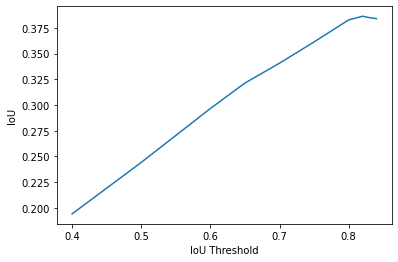

In [ ]:
from sklearn.metrics import confusion_matrix 
base_dir = '/content/drive/My Drive/Research_project/leather/ground_truth/'
iou_threshold = [0.4,0.5,0.6,0.65,0.7,0.75,.8,.82,.83,.84]

avg_iou_score = []


def Grad_Cam_Leather(train_test_bad_dataset_tensor, train_img_paths_test_bad):
  for thr in iou_threshold:
    iou_Score = []
    for i in range(len(train_test_bad_dataset_tensor)):
      #------------ IOU 
      #print(train_img_paths_test_bad[i])
      head_tail_2 = os.path.split(train_img_paths_test_bad[i])
      #print(head_tail_2[1])
      head_tail_1 = os.path.split(head_tail_2[0])
      #print(os.path.join(base_dir,head_tail_1[1], head_tail_2[1][0:3]+'_mask.png'))
      ground_truth = os.path.join(base_dir,head_tail_1[1], head_tail_2[1][0:3]+'_mask.png')
      
      test_image = Image.open(ground_truth)
      test_image = test_image.resize((256, 256), Image.ANTIALIAS)
      #ans = cv2.resize(test_image, (256, 256))
      #print(test_image.shape)



      img = train_test_bad_dataset_tensor[i]
      original_img = img  #To display image at last
      img = img.unsqueeze(0)
      model.eval()
      metric_fc.eval()
      
      temp_output = model.encoder(img)
      output = metric_fc(temp_output)
      #print(output)
      class_label = output.argmax(dim=1).item()
      class_score = output[0][1]
      med_out = My_BasicBlock.get_med_out()
      N, C, H, W = med_out.shape
      grads = torch.autograd.grad(class_score, med_out)
      w  = grads[0][0].mean(-1).mean(-1) #Calculate the weight by averaging the gradient for each channel
      ans = torch.matmul(w, med_out.view(C, H*W))
      ans = F.relu(ans)
      ans = ans.view(H, W).cpu().detach().numpy()
      #plt.imshow(ans)
      ans = cv2.resize(ans, (256, 256))
      ans = ans*1000
      ans = ans / np.amax(ans)
      #print(np.amax(ans), np.amin(ans))
      #plt.imshow(original_img.permute(1, 2, 0))
      #plt.show()

      #plt.imshow(original_img.permute(1, 2, 0))

      #ans = np.where(ans > 0.6, 1, 0)
      #plt.imshow(ans, alpha=0.5, cmap='jet')
      #plt.show()
      #plt.imshow(test_image)
      #plt.show()

    

      # IoU calculation
    
      ans = np.where(ans > thr, 1, 0)
      intersection = np.sum(np.logical_and(test_image, ans))

      union = np.sum(np.logical_or(test_image, ans))
      iou_score = intersection*2.5 / union
      iou_Score.append(iou_score) 
      
      #print('IoU is %s' % iou_score)
      #print( np.sum(iou_Score)/len(iou_Score))
    
    avg_iou_score.append(np.sum(iou_Score)/len(iou_Score))
    print(thr)

  plt.plot(iou_threshold, avg_iou_score)
  plt.xlabel("IoU Threshold")
  plt.ylabel("IoU")
  plt.show()
  #if i == 3:
  #  break





model.cpu()
Grad_Cam_Leather(train_test_bad_dataset_tensor, train_img_paths_test_bad)

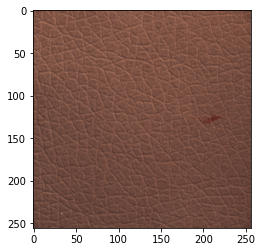

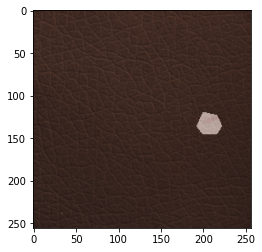

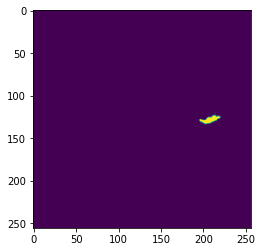

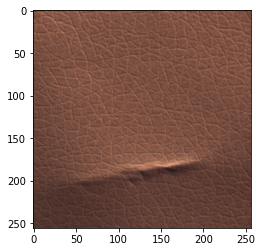

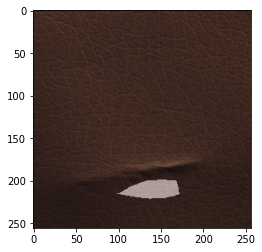

...

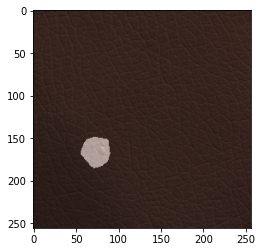

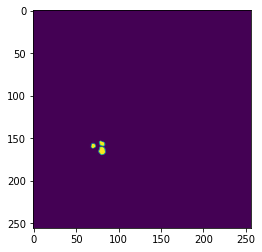

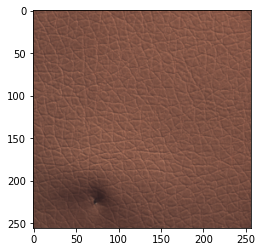

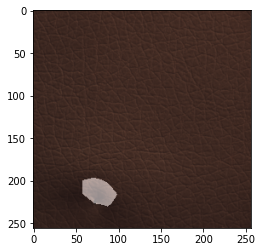

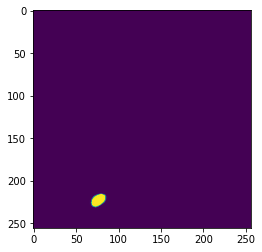

KeyboardInterrupt: ignored

In [ ]:
base_dir = '/content/drive/My Drive/Research_project/leather/ground_truth/'

def Grad_Cam_Leather(train_test_bad_dataset_tensor, train_img_paths_test_bad):
    for i in range(len(train_test_bad_dataset_tensor)):
      #------------ IOU 
      #print(train_img_paths_test_bad[i])
      head_tail_2 = os.path.split(train_img_paths_test_bad[i])
      #print(head_tail_2[1])
      head_tail_1 = os.path.split(head_tail_2[0])
      #print(os.path.join(base_dir,head_tail_1[1], head_tail_2[1][0:3]+'_mask.png'))
      ground_truth = os.path.join(base_dir,head_tail_1[1], head_tail_2[1][0:3]+'_mask.png')
      
      test_image = Image.open(ground_truth)
      test_image = test_image.resize((256, 256), Image.ANTIALIAS)

      img = train_test_bad_dataset_tensor[i]
      original_img = img  #To display image at last
      img = img.unsqueeze(0)
      model.eval()
      metric_fc.eval()
      
      temp_output = model.encoder(img)
      output = metric_fc(temp_output)
      #print(output)
      class_label = output.argmax(dim=1).item()
      class_score = output[0][1]
      med_out = My_BasicBlock.get_med_out()
      N, C, H, W = med_out.shape
      grads = torch.autograd.grad(class_score, med_out)
      w  = grads[0][0].mean(-1).mean(-1) #Calculate the weight by averaging the gradient for each channel
      ans = torch.matmul(w, med_out.view(C, H*W))
      ans = F.relu(ans)
      ans = ans.view(H, W).cpu().detach().numpy()
      ans = cv2.resize(ans, (256, 256))
      ans = ans*5000
      plt.imshow(original_img.permute(1, 2, 0))
      plt.show()

      plt.imshow(original_img.permute(1, 2, 0))

      ans = ans*1000
      ans = ans / np.amax(ans)
      ans = np.where(ans > 0.8, 1, 0)
      plt.imshow(ans, alpha=0.5, cmap='gray')
      plt.show()
      plt.imshow(test_image)
      plt.show()




model.cpu()
Grad_Cam_Leather(train_test_bad_dataset_tensor, train_img_paths_test_bad)

/content/drive/My Drive/Research_project/leather/test/color/005.png
tensor([[-0.0257, -0.0335, -0.0217, -0.0155, -0.0449,  0.0224,  0.0382,  0.0602,
         -0.0281,  0.0507]], grad_fn=<MmBackward>)


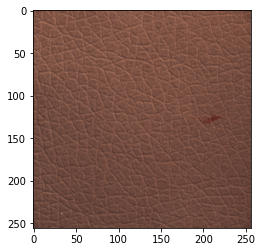

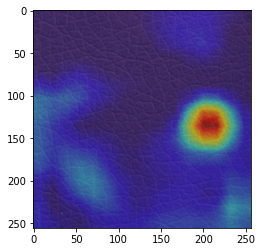

/content/drive/My Drive/Research_project/leather/test/fold/004.png
tensor([[ 0.0424, -0.0047, -0.0575, -0.0177, -0.0619,  0.0209, -0.0685,  0.0216,
         -0.0055,  0.0060]], grad_fn=<MmBackward>)


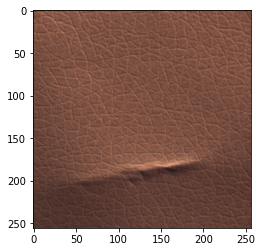

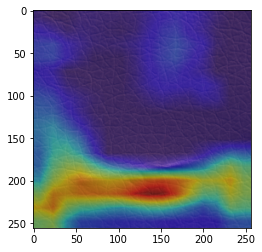

/content/drive/My Drive/Research_project/leather/test/fold/012.png
tensor([[ 0.0002, -0.0211,  0.0191, -0.0399, -0.0895,  0.0659,  0.0406, -0.0281,
          0.0002,  0.0049]], grad_fn=<MmBackward>)


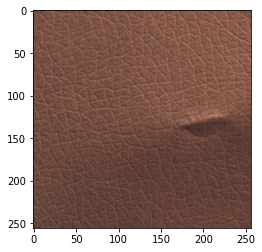

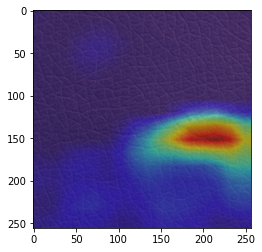

/content/drive/My Drive/Research_project/leather/test/color/018.png
tensor([[-0.0201, -0.0389,  0.0066,  0.0135, -0.0313, -0.0060, -0.0535,  0.0775,
         -0.0480,  0.0503]], grad_fn=<MmBackward>)


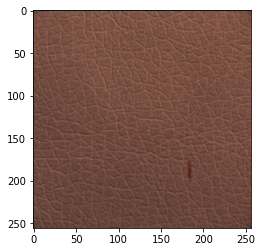

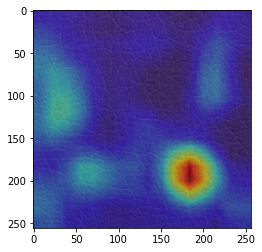

/content/drive/My Drive/Research_project/leather/test/color/017.png
tensor([[-0.0072, -0.0658, -0.0071, -0.0163, -0.0184,  0.0319,  0.0359,  0.0464,
         -0.0330,  0.0348]], grad_fn=<MmBackward>)


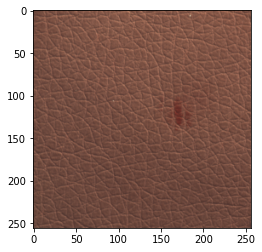

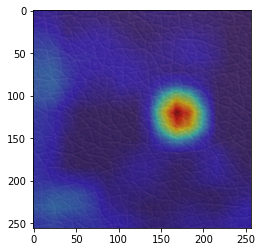

/content/drive/My Drive/Research_project/leather/test/fold/016.png
tensor([[ 0.0380, -0.0118, -0.0526,  0.0034,  0.0267,  0.0601, -0.0124, -0.0248,
          0.0580, -0.0122]], grad_fn=<MmBackward>)


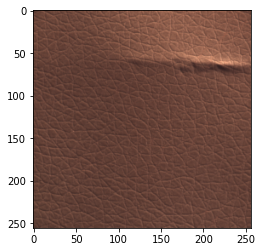

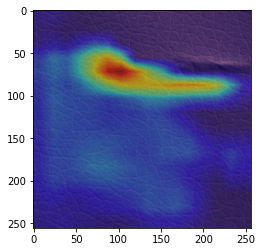

/content/drive/My Drive/Research_project/leather/test/fold/011.png
tensor([[-0.0124, -0.0255, -0.0357, -0.0293, -0.0242,  0.0014,  0.0274,  0.0249,
          0.0544,  0.0805]], grad_fn=<MmBackward>)


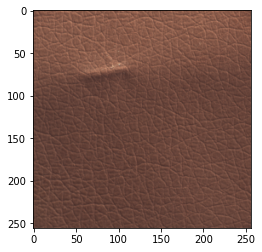

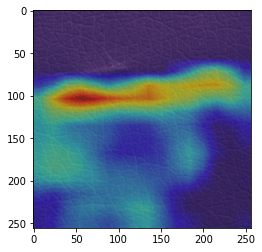

/content/drive/My Drive/Research_project/leather/test/fold/009.png
tensor([[-0.0247, -0.0087, -0.0597,  0.0163, -0.0110,  0.0312,  0.0283, -0.0126,
         -0.0302,  0.0053]], grad_fn=<MmBackward>)


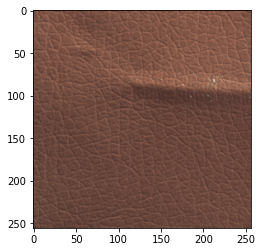

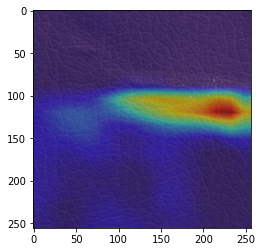

/content/drive/My Drive/Research_project/leather/test/color/002.png
tensor([[ 0.0563, -0.0186,  0.0187, -0.0050, -0.0228,  0.0729, -0.0236,  0.0528,
         -0.0616,  0.0027]], grad_fn=<MmBackward>)


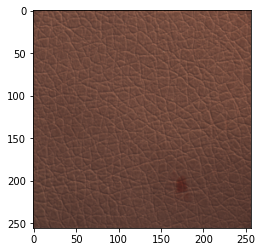

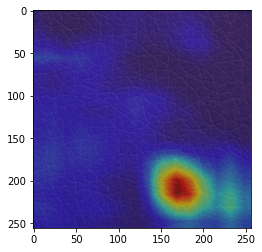

/content/drive/My Drive/Research_project/leather/test/poke/013.png
tensor([[ 0.0337, -0.0338,  0.0042, -0.0571, -0.0027, -0.0046,  0.0268,  0.0598,
         -0.0019,  0.0330]], grad_fn=<MmBackward>)


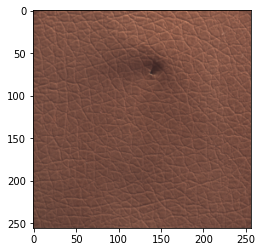

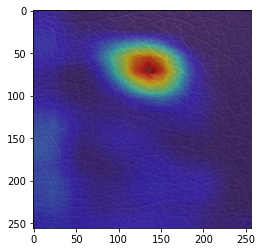

/content/drive/My Drive/Research_project/leather/test/cut/006.png
tensor([[-0.0289,  0.0898, -0.0209, -0.0521,  0.0043, -0.0124, -0.0338, -0.0301,
          0.0748,  0.0104]], grad_fn=<MmBackward>)


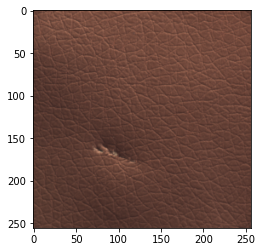

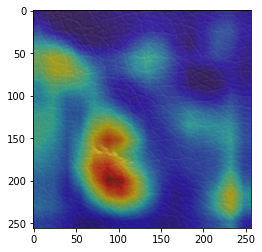

/content/drive/My Drive/Research_project/leather/test/glue/016.png
tensor([[ 0.0100, -0.0507,  0.0013, -0.0109, -0.0493,  0.0135,  0.0101,  0.0474,
         -0.0599,  0.0315]], grad_fn=<MmBackward>)


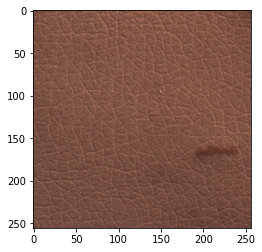

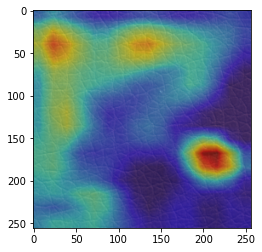

/content/drive/My Drive/Research_project/leather/test/poke/014.png
tensor([[-0.0045, -0.0189, -0.0145, -0.0530, -0.0483, -0.0012, -0.0026, -0.0074,
         -0.0169,  0.0754]], grad_fn=<MmBackward>)


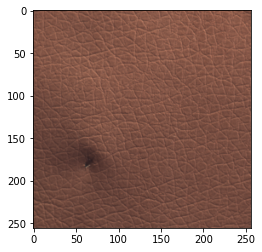

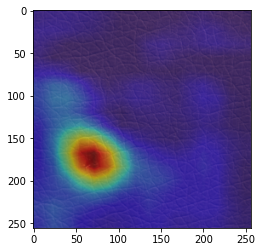

/content/drive/My Drive/Research_project/leather/test/color/009.png
tensor([[ 0.0035, -0.0592, -0.0140,  0.0191, -0.0143,  0.0093,  0.0166,  0.0779,
         -0.0252,  0.0620]], grad_fn=<MmBackward>)


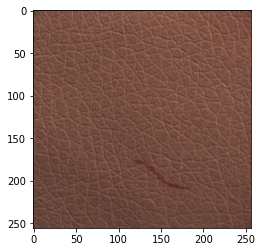

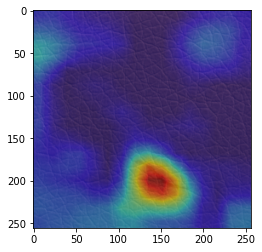

/content/drive/My Drive/Research_project/leather/test/cut/008.png
tensor([[-0.0030, -0.0072, -0.0186,  0.0029, -0.0474, -0.0344,  0.0263,  0.0041,
          0.0239, -0.0719]], grad_fn=<MmBackward>)


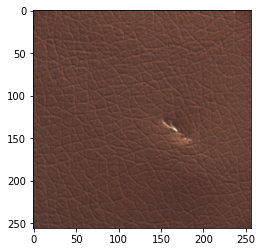

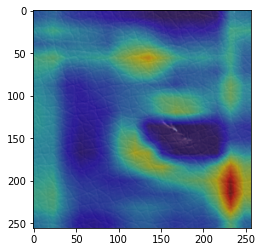

/content/drive/My Drive/Research_project/leather/test/glue/003.png
tensor([[ 0.0840, -0.0154, -0.0616,  0.0123,  0.0197,  0.0652, -0.0034, -0.0138,
         -0.0195, -0.0191]], grad_fn=<MmBackward>)


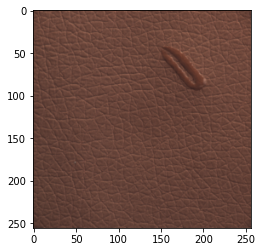

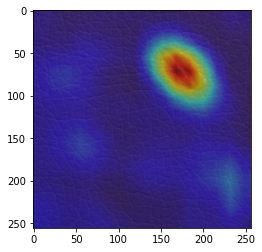

/content/drive/My Drive/Research_project/leather/test/color/012.png
tensor([[-0.0175, -0.0699, -0.0200, -0.0351, -0.0262,  0.0373,  0.0014,  0.0242,
         -0.0178,  0.0389]], grad_fn=<MmBackward>)


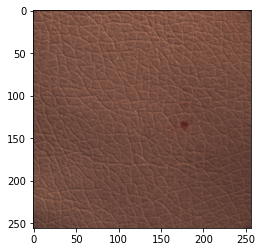

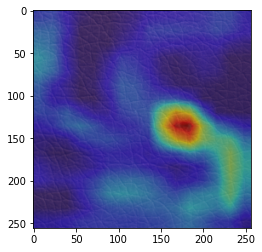

/content/drive/My Drive/Research_project/leather/test/cut/012.png
tensor([[-0.0294, -0.0114, -0.0507,  0.0282, -0.1120,  0.0387, -0.0065,  0.0049,
          0.0144, -0.0298]], grad_fn=<MmBackward>)


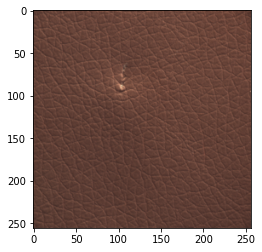

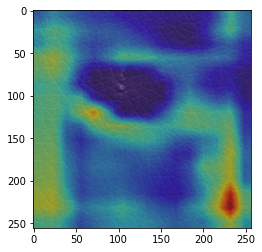

/content/drive/My Drive/Research_project/leather/test/color/016.png
tensor([[-1.3138e-02, -7.2452e-02, -2.1135e-02,  2.8830e-03, -1.8995e-02,
          3.4636e-05,  2.4907e-02,  8.6818e-02, -5.5774e-02,  5.7012e-02]],
       grad_fn=<MmBackward>)


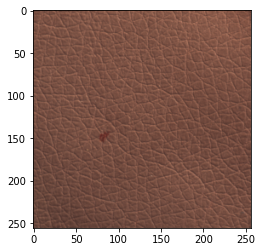

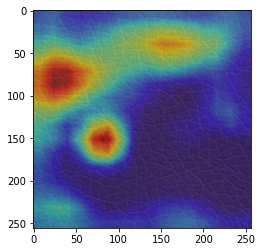

/content/drive/My Drive/Research_project/leather/test/color/003.png
tensor([[ 0.0157, -0.0474, -0.0273,  0.0114, -0.0445, -0.0187, -0.0115,  0.1172,
         -0.0469,  0.0521]], grad_fn=<MmBackward>)


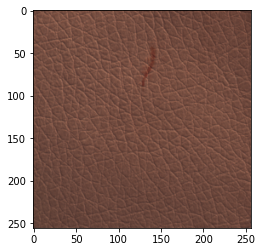

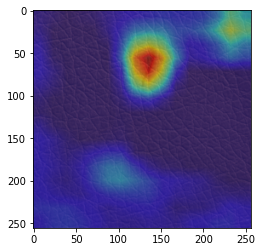

/content/drive/My Drive/Research_project/leather/test/fold/007.png
tensor([[ 0.0052, -0.0186, -0.0512, -0.0135, -0.0637,  0.0440, -0.0612, -0.0524,
         -0.0038,  0.0515]], grad_fn=<MmBackward>)


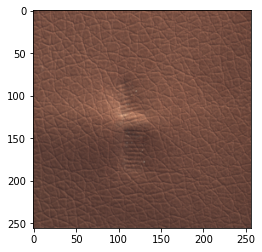

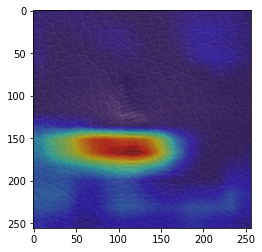

/content/drive/My Drive/Research_project/leather/test/cut/004.png
tensor([[ 0.0947,  0.0294, -0.0424, -0.0025, -0.0257,  0.0445,  0.0068, -0.0138,
          0.0754, -0.0506]], grad_fn=<MmBackward>)


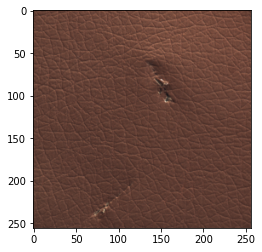

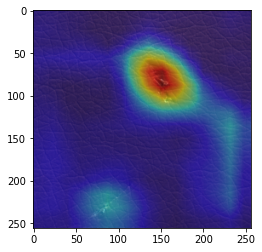

/content/drive/My Drive/Research_project/leather/test/fold/014.png
tensor([[-0.0501, -0.0291, -0.0276, -0.0205, -0.0616, -0.0049,  0.0021,  0.0144,
         -0.0032, -0.0291]], grad_fn=<MmBackward>)


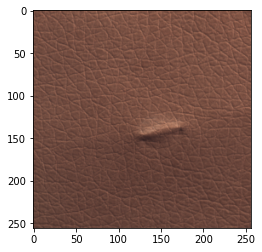

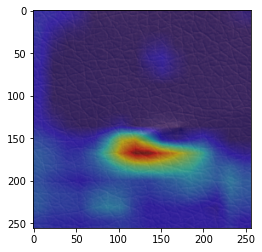

/content/drive/My Drive/Research_project/leather/test/cut/005.png
tensor([[ 0.0567,  0.0275,  0.0009,  0.0339, -0.0305, -0.0034,  0.0138,  0.0521,
          0.0531, -0.0471]], grad_fn=<MmBackward>)


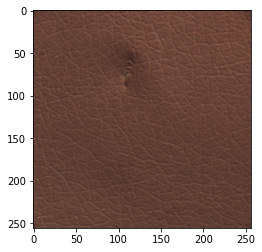

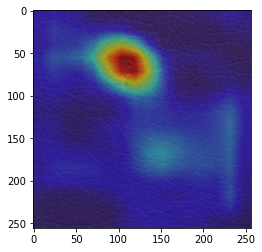

/content/drive/My Drive/Research_project/leather/test/glue/018.png
tensor([[-0.0190, -0.0511, -0.0201, -0.0356, -0.0455,  0.0192,  0.0391,  0.0350,
         -0.0229,  0.0576]], grad_fn=<MmBackward>)


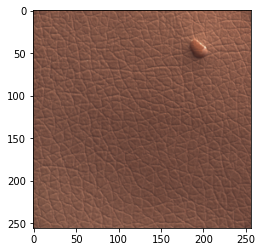

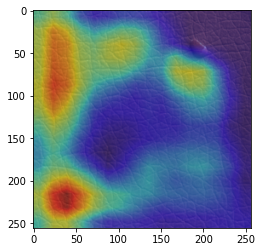

/content/drive/My Drive/Research_project/leather/test/poke/017.png
tensor([[ 0.0003, -0.0272,  0.0156, -0.0126, -0.0289,  0.0282,  0.0064, -0.0011,
         -0.0388,  0.0148]], grad_fn=<MmBackward>)


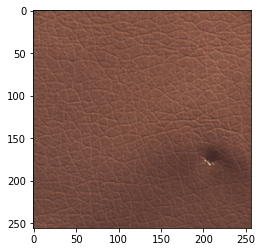

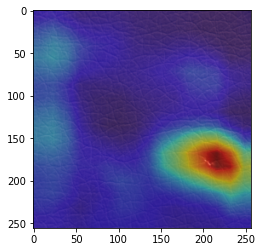

/content/drive/My Drive/Research_project/leather/test/cut/014.png
tensor([[-0.0359,  0.0568, -0.0651, -0.0160, -0.0123,  0.0071,  0.0038, -0.0050,
          0.0465,  0.0100]], grad_fn=<MmBackward>)


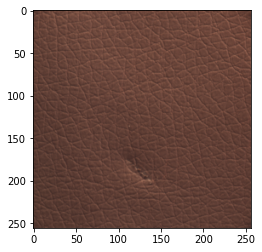

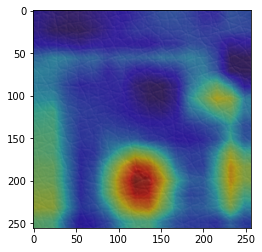

/content/drive/My Drive/Research_project/leather/test/cut/010.png
tensor([[ 0.0160,  0.0047, -0.0098, -0.0280, -0.0668,  0.0173,  0.0329,  0.0322,
          0.1023, -0.0860]], grad_fn=<MmBackward>)


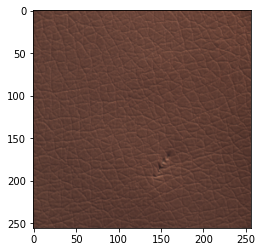

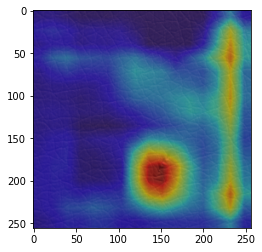

/content/drive/My Drive/Research_project/leather/test/fold/015.png
tensor([[-2.5554e-02, -3.3092e-03,  1.1718e-02, -7.3113e-03, -8.0987e-02,
          8.6863e-05,  1.6558e-02,  1.3034e-02, -5.8765e-03, -1.9711e-02]],
       grad_fn=<MmBackward>)


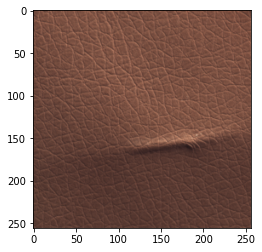

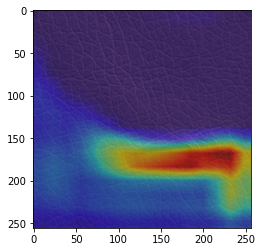

/content/drive/My Drive/Research_project/leather/test/color/001.png
tensor([[ 0.0576, -0.0271, -0.0332,  0.0082, -0.0332,  0.0039,  0.0292,  0.0746,
          0.0476, -0.0254]], grad_fn=<MmBackward>)


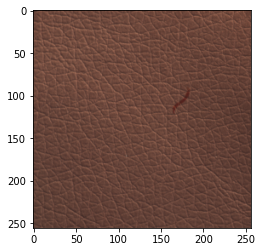

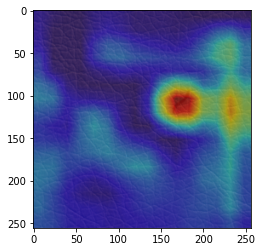

/content/drive/My Drive/Research_project/leather/test/cut/017.png
tensor([[-0.0632, -0.0157, -0.0214,  0.0335, -0.1038,  0.0465,  0.0398, -0.1160,
          0.0311, -0.0604]], grad_fn=<MmBackward>)


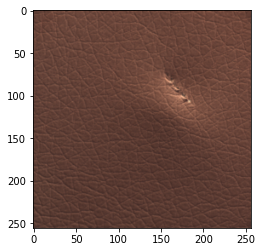

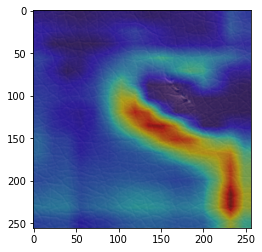

/content/drive/My Drive/Research_project/leather/test/fold/005.png
tensor([[-0.0071, -0.0806, -0.0613,  0.0209, -0.0663,  0.0319,  0.0466, -0.0283,
          0.0014,  0.0650]], grad_fn=<MmBackward>)


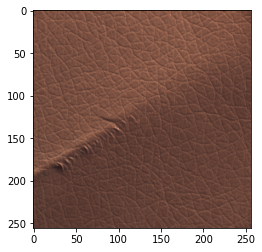

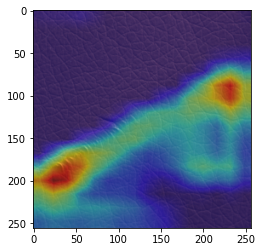

/content/drive/My Drive/Research_project/leather/test/cut/016.png
tensor([[ 0.0326, -0.0175, -0.0292, -0.0022, -0.0673, -0.0446,  0.0144,  0.0203,
          0.0193, -0.0310]], grad_fn=<MmBackward>)


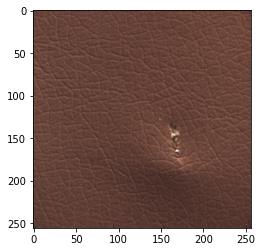

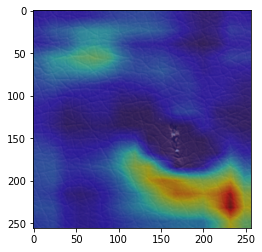

/content/drive/My Drive/Research_project/leather/test/glue/013.png
tensor([[-0.0002, -0.0394, -0.0464, -0.0396, -0.0531,  0.0355,  0.0182, -0.0121,
          0.0132, -0.0092]], grad_fn=<MmBackward>)


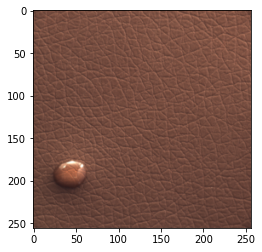

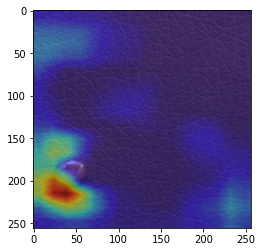

/content/drive/My Drive/Research_project/leather/test/poke/011.png
tensor([[-0.0181, -0.0358, -0.0259, -0.0316, -0.0491, -0.0062,  0.0301,  0.0438,
         -0.0057,  0.0312]], grad_fn=<MmBackward>)


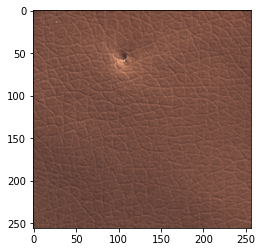

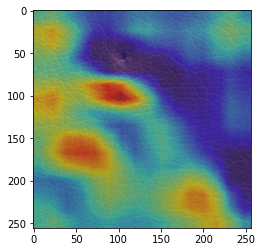

/content/drive/My Drive/Research_project/leather/test/glue/014.png
tensor([[-0.0545,  0.0065, -0.0157, -0.0328, -0.0087, -0.0002, -0.0103,  0.0705,
          0.0207,  0.0470]], grad_fn=<MmBackward>)


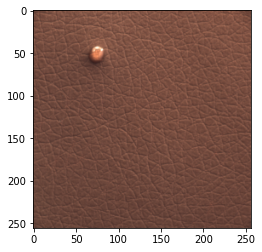

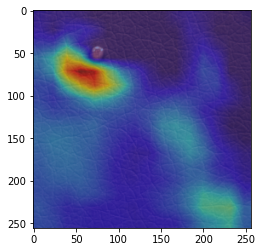

/content/drive/My Drive/Research_project/leather/test/glue/000.png
tensor([[-0.0241,  0.0046, -0.0246,  0.0265, -0.0577,  0.0089,  0.0281, -0.1017,
          0.0118, -0.0917]], grad_fn=<MmBackward>)


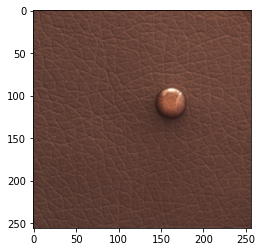

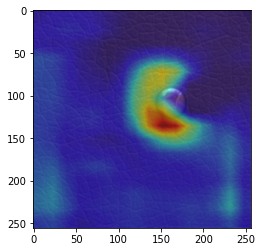

/content/drive/My Drive/Research_project/leather/test/glue/001.png
tensor([[-0.0011,  0.0779, -0.0479, -0.0295,  0.0124,  0.0290, -0.0751, -0.1185,
          0.0299, -0.0658]], grad_fn=<MmBackward>)


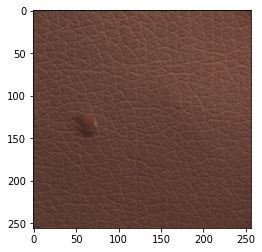

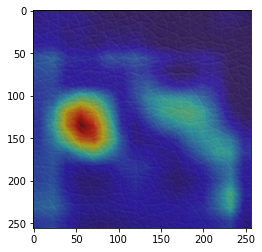

/content/drive/My Drive/Research_project/leather/test/color/006.png
tensor([[-0.0333, -0.0260,  0.0103, -0.0163, -0.0100, -0.0052,  0.0202,  0.0586,
         -0.0357,  0.0225]], grad_fn=<MmBackward>)


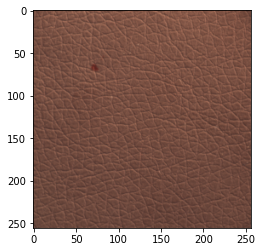

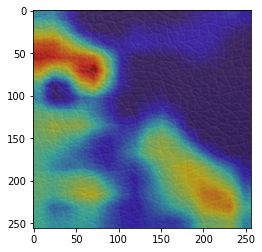

/content/drive/My Drive/Research_project/leather/test/cut/015.png
tensor([[-0.0199, -0.0330, -0.0007,  0.0224, -0.0339, -0.0122,  0.0271,  0.0368,
          0.0442, -0.0298]], grad_fn=<MmBackward>)


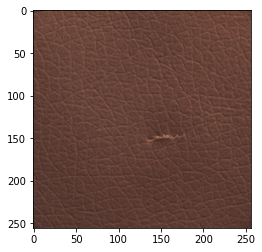

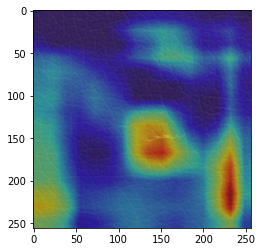

/content/drive/My Drive/Research_project/leather/test/cut/003.png
tensor([[ 0.0481,  0.0708, -0.0348,  0.0494,  0.0005,  0.0120,  0.0499, -0.0558,
          0.0191, -0.0818]], grad_fn=<MmBackward>)


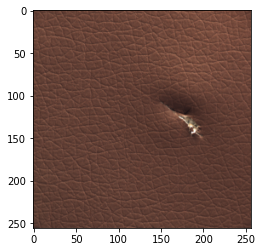

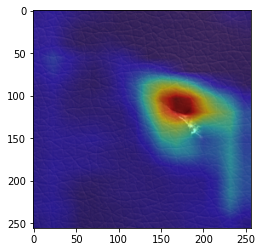

/content/drive/My Drive/Research_project/leather/test/glue/009.png
tensor([[-0.0376,  0.0831, -0.0706,  0.0018,  0.0389, -0.0006, -0.0678, -0.0825,
         -0.0029,  0.0024]], grad_fn=<MmBackward>)


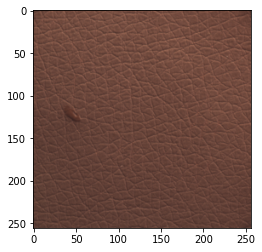

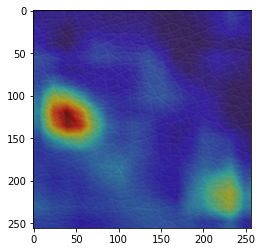

/content/drive/My Drive/Research_project/leather/test/glue/004.png
tensor([[-0.0022,  0.0405, -0.0532,  0.0576, -0.0446, -0.0170, -0.0579, -0.0006,
         -0.0807,  0.0251]], grad_fn=<MmBackward>)


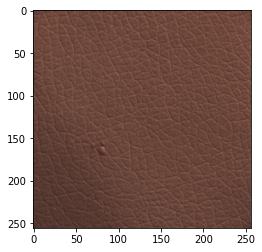

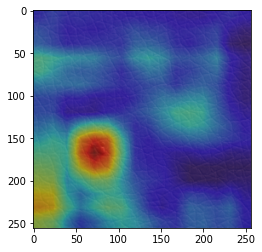

/content/drive/My Drive/Research_project/leather/test/poke/006.png
tensor([[ 0.0264, -0.0102, -0.0122, -0.0486, -0.0270,  0.0287,  0.0115,  0.0472,
         -0.0316,  0.0485]], grad_fn=<MmBackward>)


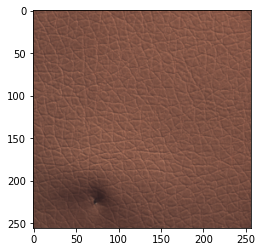

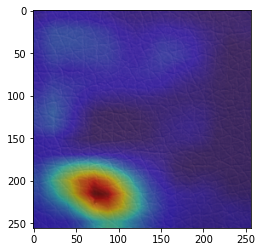

/content/drive/My Drive/Research_project/leather/test/cut/002.png
tensor([[-0.0131,  0.0695, -0.0277, -0.0152,  0.0188,  0.0044, -0.0028, -0.0013,
          0.0710, -0.0255]], grad_fn=<MmBackward>)


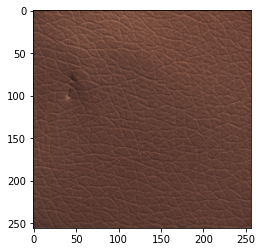

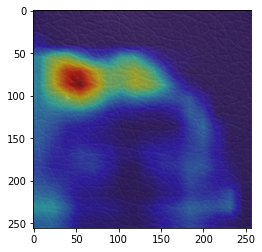

/content/drive/My Drive/Research_project/leather/test/poke/003.png
tensor([[-0.0269, -0.0314, -0.0444,  0.0040, -0.0567,  0.0130, -0.0085, -0.0115,
         -0.0327,  0.0427]], grad_fn=<MmBackward>)


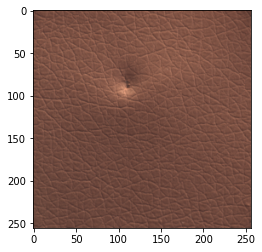

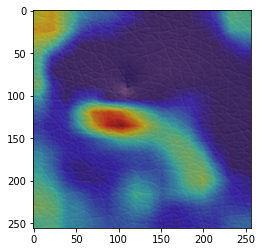

/content/drive/My Drive/Research_project/leather/test/poke/000.png
tensor([[-0.0182, -0.0316, -0.0227, -0.0438, -0.0417,  0.0296,  0.0223,  0.0127,
         -0.0148,  0.0572]], grad_fn=<MmBackward>)


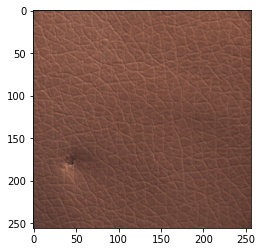

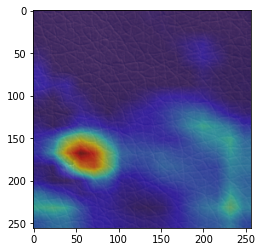

/content/drive/My Drive/Research_project/leather/test/color/015.png
tensor([[-0.0261, -0.0451, -0.0352, -0.0123, -0.0039, -0.0031,  0.0344,  0.0568,
         -0.0593,  0.0433]], grad_fn=<MmBackward>)


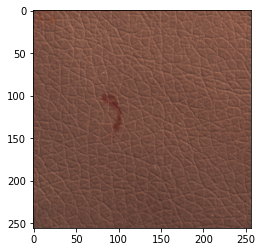

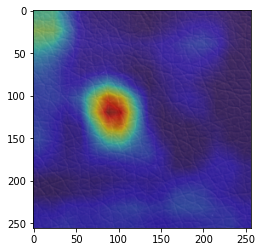

/content/drive/My Drive/Research_project/leather/test/cut/009.png
tensor([[-0.0160,  0.0095, -0.0071, -0.0069, -0.0400,  0.0260,  0.0227,  0.0349,
          0.0747, -0.0378]], grad_fn=<MmBackward>)


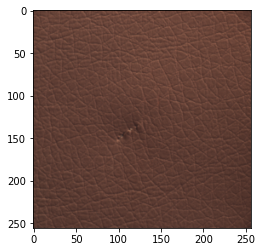

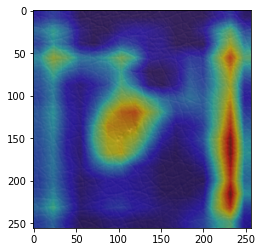

/content/drive/My Drive/Research_project/leather/test/poke/001.png
tensor([[-0.0250, -0.0736,  0.0010, -0.0210, -0.0422,  0.0010,  0.0251,  0.0387,
         -0.0296,  0.0599]], grad_fn=<MmBackward>)


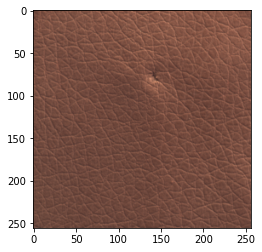

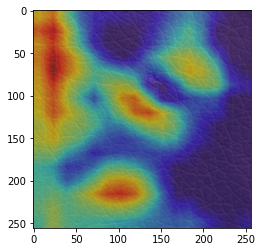

/content/drive/My Drive/Research_project/leather/test/glue/005.png
tensor([[ 0.0068,  0.0292, -0.0619, -0.0410, -0.0759,  0.0263, -0.0493, -0.0141,
         -0.0033, -0.0512]], grad_fn=<MmBackward>)


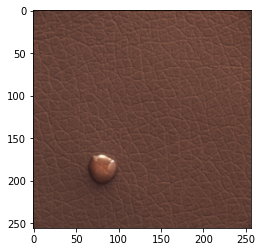

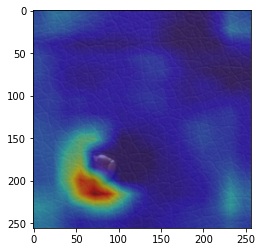

/content/drive/My Drive/Research_project/leather/test/color/007.png
tensor([[-0.0015, -0.0294, -0.0011, -0.0122,  0.0067,  0.0823,  0.0191,  0.0138,
         -0.0274,  0.0256]], grad_fn=<MmBackward>)


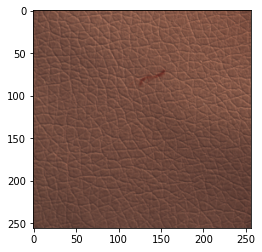

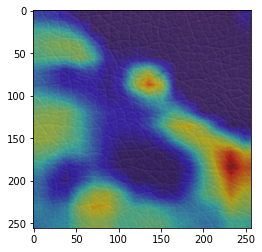

/content/drive/My Drive/Research_project/leather/test/fold/006.png
tensor([[ 0.0561, -0.0355, -0.0305, -0.0016, -0.0712,  0.0004, -0.0626, -0.0076,
         -0.0254, -0.0009]], grad_fn=<MmBackward>)


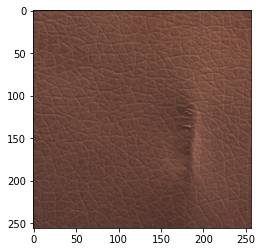

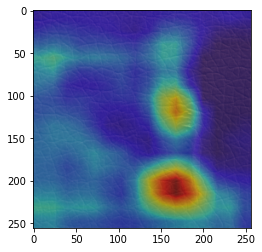

/content/drive/My Drive/Research_project/leather/test/glue/007.png
tensor([[ 0.0616,  0.0302, -0.0273,  0.0052, -0.0546, -0.0173,  0.0232,  0.1010,
          0.0107, -0.0251]], grad_fn=<MmBackward>)


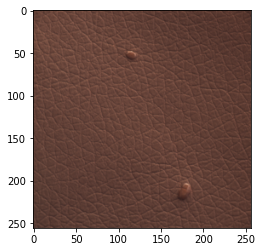

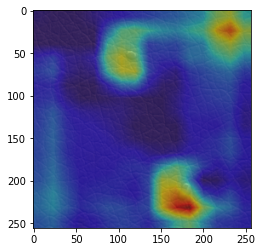

/content/drive/My Drive/Research_project/leather/test/glue/006.png
tensor([[-0.0559, -0.0117, -0.0213, -0.0023, -0.0678, -0.0096,  0.0320, -0.0158,
          0.0077, -0.0702]], grad_fn=<MmBackward>)


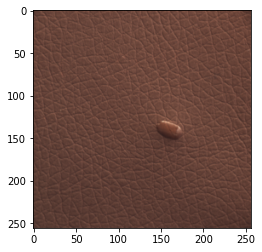

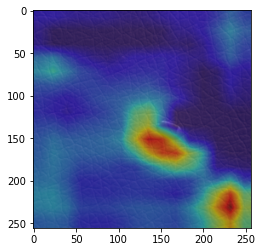

/content/drive/My Drive/Research_project/leather/test/fold/008.png
tensor([[-0.0565, -0.0649, -0.0172,  0.0437, -0.0658, -0.0039,  0.0101, -0.0013,
         -0.0301,  0.0047]], grad_fn=<MmBackward>)


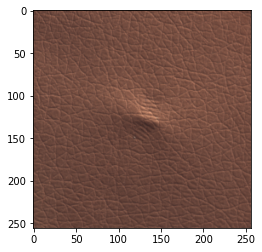

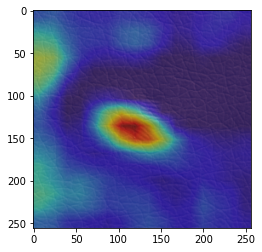

/content/drive/My Drive/Research_project/leather/test/fold/000.png
tensor([[ 0.0139, -0.0057, -0.0439, -0.0164,  0.0251,  0.0359,  0.0066,  0.0101,
          0.0365, -0.0311]], grad_fn=<MmBackward>)


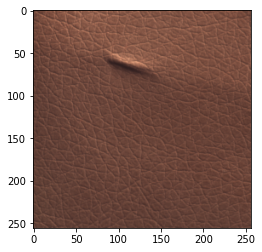

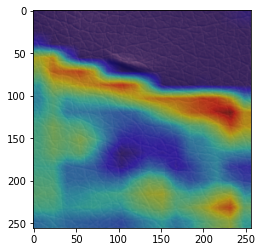

/content/drive/My Drive/Research_project/leather/test/poke/009.png
tensor([[ 0.0082, -0.0348, -0.0071, -0.0445, -0.0535, -0.0078,  0.0233,  0.0146,
         -0.0135,  0.0345]], grad_fn=<MmBackward>)


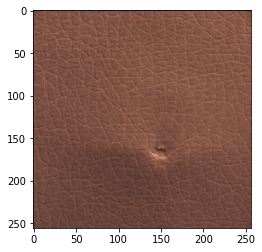

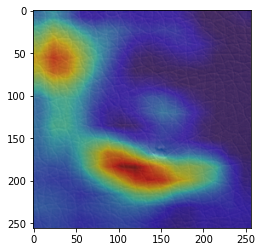

/content/drive/My Drive/Research_project/leather/test/glue/008.png
tensor([[ 0.0948, -0.0364, -0.1011, -0.0249, -0.0383,  0.0737, -0.0014,  0.0896,
         -0.0418,  0.0302]], grad_fn=<MmBackward>)


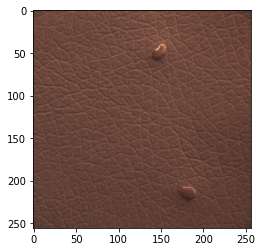

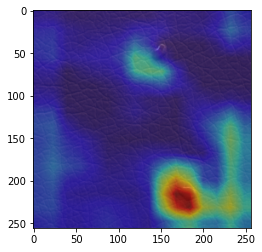

/content/drive/My Drive/Research_project/leather/test/cut/007.png
tensor([[-0.0267, -0.0700, -0.0674,  0.0316, -0.1165,  0.0092,  0.0559, -0.0308,
          0.0176, -0.0737]], grad_fn=<MmBackward>)


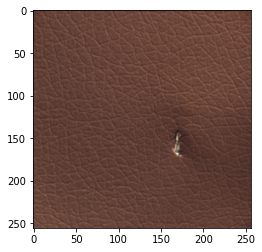

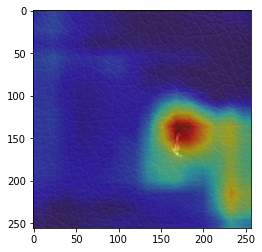

/content/drive/My Drive/Research_project/leather/test/fold/001.png
tensor([[-0.0276, -0.0165, -0.0146, -0.0262, -0.0220,  0.0180, -0.0305,  0.0457,
         -0.0152,  0.0489]], grad_fn=<MmBackward>)


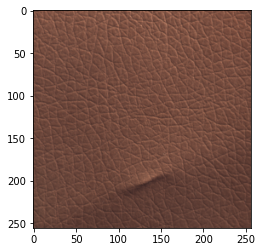

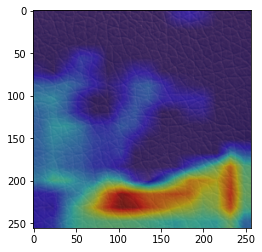

/content/drive/My Drive/Research_project/leather/test/poke/002.png
tensor([[ 0.0084, -0.0247, -0.0202, -0.0523, -0.0362,  0.0033,  0.0066,  0.0033,
          0.0168,  0.0612]], grad_fn=<MmBackward>)


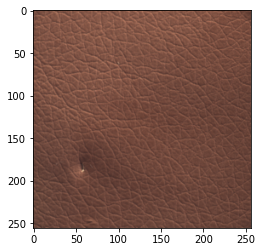

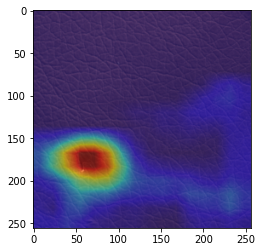

/content/drive/My Drive/Research_project/leather/test/fold/010.png
tensor([[-0.0011, -0.0608, -0.0435, -0.0199, -0.0706, -0.0204, -0.0229,  0.0245,
         -0.0319,  0.0457]], grad_fn=<MmBackward>)


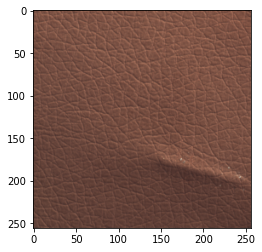

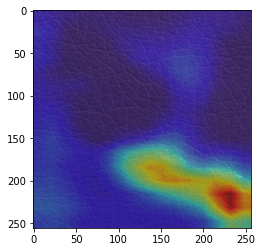

/content/drive/My Drive/Research_project/leather/test/color/014.png
tensor([[ 0.0019, -0.0747,  0.0063,  0.0120, -0.0329, -0.0175, -0.0100,  0.1211,
         -0.0465,  0.0773]], grad_fn=<MmBackward>)


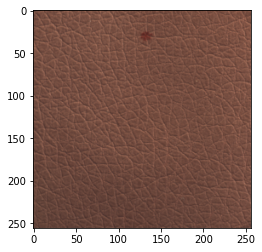

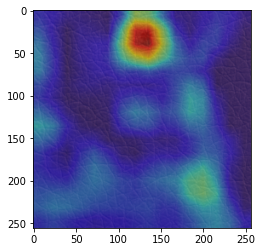

/content/drive/My Drive/Research_project/leather/test/color/000.png
tensor([[ 0.0340, -0.0460,  0.0323, -0.0123, -0.0493,  0.0192, -0.0481,  0.0489,
         -0.0093,  0.0449]], grad_fn=<MmBackward>)


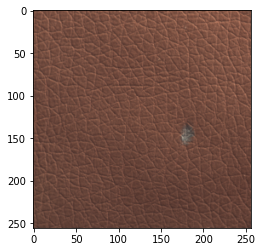

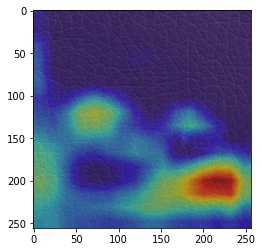

/content/drive/My Drive/Research_project/leather/test/color/013.png
tensor([[-0.0091, -0.0195, -0.0199, -0.0215, -0.0384, -0.0121, -0.0098,  0.0584,
         -0.0213,  0.0521]], grad_fn=<MmBackward>)


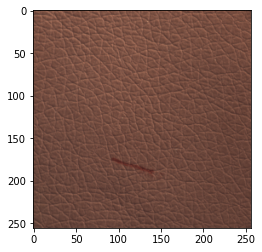

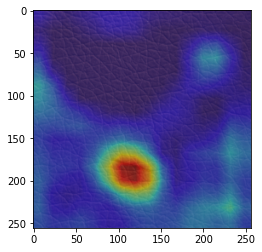

/content/drive/My Drive/Research_project/leather/test/cut/000.png
tensor([[-0.0214,  0.0597, -0.0712,  0.0002, -0.0123,  0.0306,  0.0168, -0.0028,
          0.0487, -0.0446]], grad_fn=<MmBackward>)


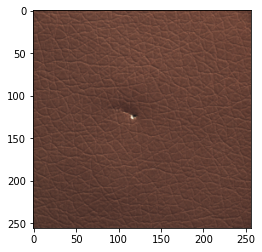

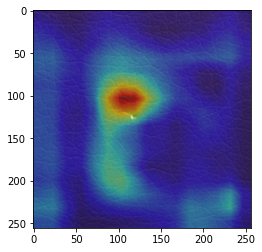

/content/drive/My Drive/Research_project/leather/test/cut/018.png
tensor([[-0.0228, -0.0255, -0.0527,  0.0013, -0.0012,  0.0410,  0.0114, -0.0187,
         -0.0216, -0.0226]], grad_fn=<MmBackward>)


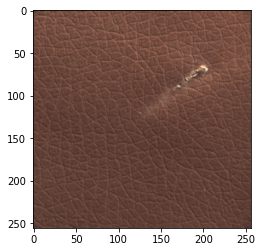

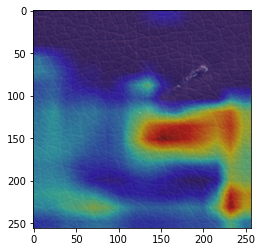

/content/drive/My Drive/Research_project/leather/test/poke/015.png
tensor([[-0.0124, -0.0575, -0.0173, -0.0018, -0.0320, -0.0040,  0.0285,  0.0052,
         -0.0309,  0.0416]], grad_fn=<MmBackward>)


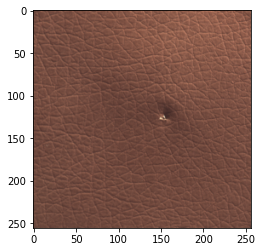

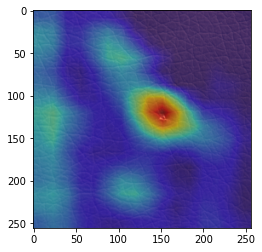

/content/drive/My Drive/Research_project/leather/test/poke/012.png
tensor([[-0.0253, -0.0185, -0.0348, -0.0195, -0.0295,  0.0102,  0.0402, -0.0146,
         -0.0085,  0.0445]], grad_fn=<MmBackward>)


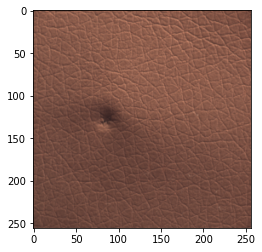

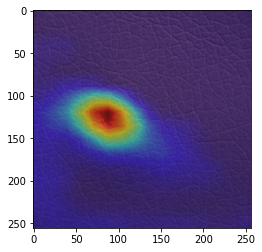

/content/drive/My Drive/Research_project/leather/test/poke/005.png
tensor([[-0.0779, -0.0629, -0.0520, -0.0334, -0.0151,  0.0449,  0.0459,  0.0107,
         -0.0241,  0.0562]], grad_fn=<MmBackward>)


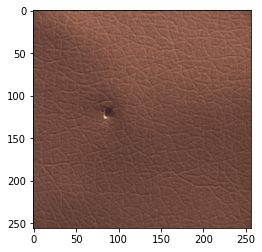

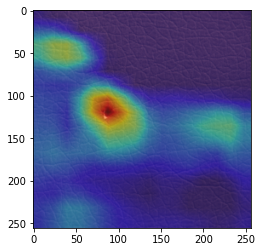

/content/drive/My Drive/Research_project/leather/test/poke/016.png
tensor([[ 0.0013, -0.0103,  0.0159, -0.0464, -0.0196,  0.0042,  0.0387,  0.0155,
         -0.0078, -0.0020]], grad_fn=<MmBackward>)


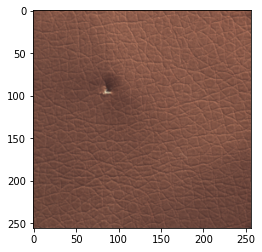

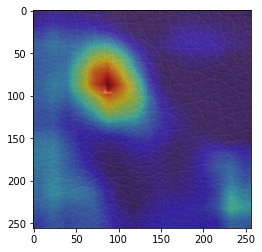

/content/drive/My Drive/Research_project/leather/test/color/011.png
tensor([[-0.0124, -0.0499,  0.0002, -0.0091, -0.0193, -0.0010,  0.0215,  0.0540,
         -0.0289,  0.0707]], grad_fn=<MmBackward>)


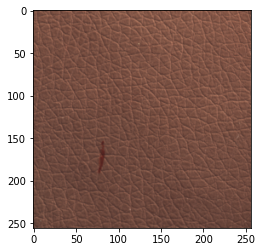

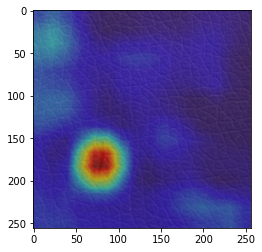

In [ ]:
model.cpu()
Grad_Cam_Leather(train_test_bad_dataset_tensor, train_img_paths_test_bad)

/content/drive/My Drive/Research_project/leather/test/cut/011.png
tensor([[-0.0008,  0.0087, -0.0276, -0.0191, -0.0533,  0.0149,  0.0133, -0.0072,
          0.0523, -0.0670]], grad_fn=<MmBackward>)


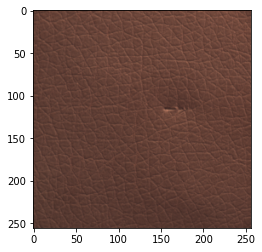

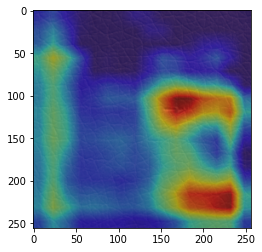

/content/drive/My Drive/Research_project/leather/test/glue/002.png
tensor([[-0.0051,  0.0176, -0.0305,  0.0268, -0.0587,  0.0234, -0.0153, -0.0541,
          0.0675, -0.1251]], grad_fn=<MmBackward>)


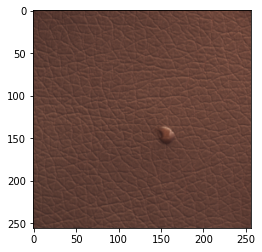

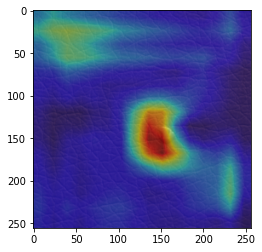

/content/drive/My Drive/Research_project/leather/test/poke/007.png
tensor([[-0.0443, -0.0462, -0.0354, -0.0092, -0.0473,  0.0076,  0.0413,  0.0184,
         -0.0151,  0.0569]], grad_fn=<MmBackward>)


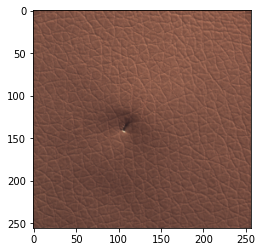

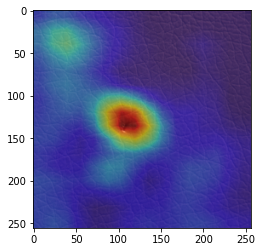

/content/drive/My Drive/Research_project/leather/test/color/004.png
tensor([[-0.0185, -0.0317,  0.0105, -0.0311, -0.0318, -0.0063,  0.0032,  0.0930,
         -0.0245,  0.0629]], grad_fn=<MmBackward>)


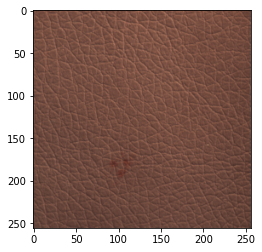

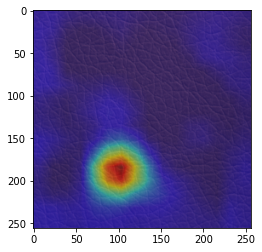

/content/drive/My Drive/Research_project/leather/test/poke/010.png
tensor([[ 0.0058, -0.0672, -0.0533, -0.0563, -0.0070,  0.0250,  0.0210,  0.0140,
         -0.0338,  0.0156]], grad_fn=<MmBackward>)


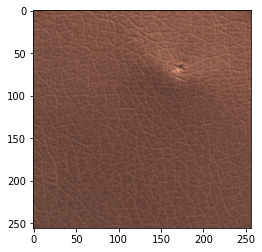

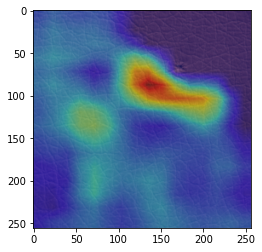

/content/drive/My Drive/Research_project/leather/test/fold/002.png
tensor([[-0.0291, -0.0164, -0.0189,  0.0045, -0.0433,  0.0245,  0.0180, -0.0239,
         -0.0186, -0.0690]], grad_fn=<MmBackward>)


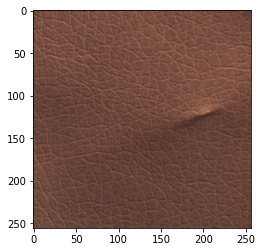

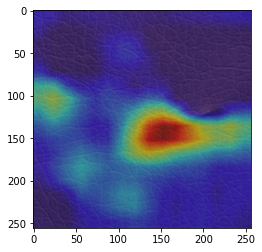

/content/drive/My Drive/Research_project/leather/test/poke/004.png
tensor([[-0.0254, -0.0234, -0.0203, -0.0142, -0.0203,  0.0368,  0.0256,  0.0080,
         -0.0225,  0.0173]], grad_fn=<MmBackward>)


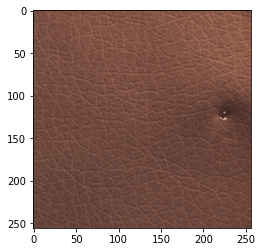

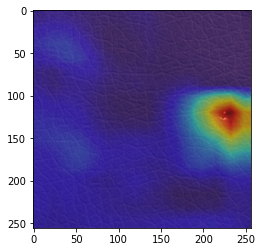

/content/drive/My Drive/Research_project/leather/test/glue/015.png
tensor([[-0.0251, -0.0329, -0.0529, -0.0284, -0.0374,  0.0439, -0.0559, -0.0372,
         -0.0293,  0.0478]], grad_fn=<MmBackward>)


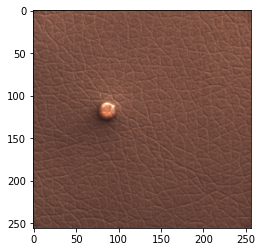

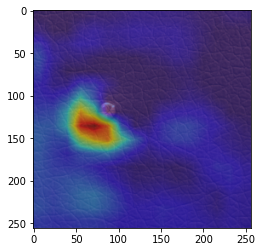

/content/drive/My Drive/Research_project/leather/test/glue/017.png
tensor([[-0.0079, -0.0290, -0.0086, -0.0156, -0.0522,  0.0336,  0.0582, -0.0109,
         -0.0260,  0.0199]], grad_fn=<MmBackward>)


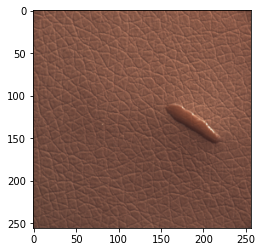

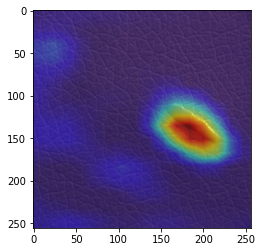

/content/drive/My Drive/Research_project/leather/test/glue/011.png
tensor([[ 0.0861,  0.0124, -0.0697, -0.0317, -0.0717,  0.0642, -0.0030, -0.0046,
          0.0198, -0.0228]], grad_fn=<MmBackward>)


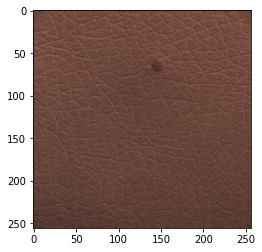

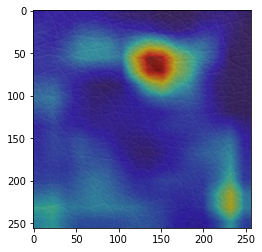

/content/drive/My Drive/Research_project/leather/test/cut/001.png
tensor([[-0.0369,  0.0238, -0.0239,  0.0047, -0.0045,  0.0005,  0.0210,  0.0486,
          0.0756,  0.0153]], grad_fn=<MmBackward>)


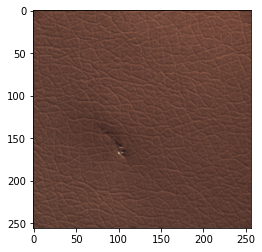

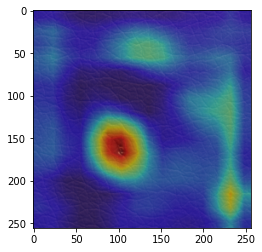

/content/drive/My Drive/Research_project/leather/test/cut/013.png
tensor([[ 0.0528,  0.0557, -0.0134,  0.0300, -0.0816, -0.0190, -0.0084, -0.0276,
         -0.0133, -0.0987]], grad_fn=<MmBackward>)


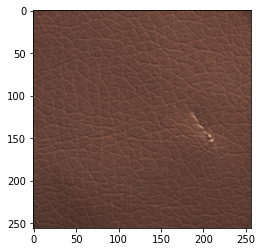

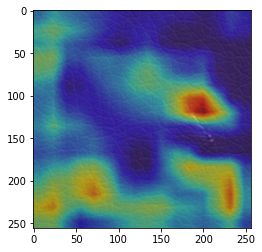

/content/drive/My Drive/Research_project/leather/test/color/008.png
tensor([[-0.0399, -0.0811, -0.0101,  0.0101, -0.0425,  0.0299,  0.0307,  0.0530,
         -0.0284,  0.0588]], grad_fn=<MmBackward>)


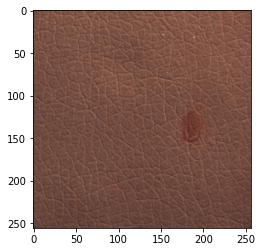

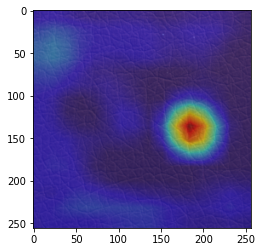

/content/drive/My Drive/Research_project/leather/test/color/010.png
tensor([[-0.0278, -0.0367,  0.0171,  0.0050, -0.0399, -0.0002,  0.0274,  0.0871,
         -0.0504,  0.0716]], grad_fn=<MmBackward>)


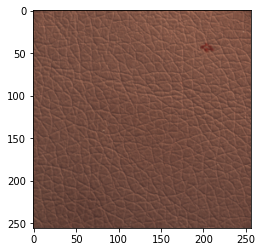

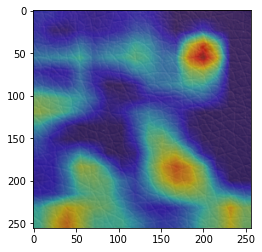

/content/drive/My Drive/Research_project/leather/test/glue/010.png
tensor([[-0.0145,  0.0560, -0.0265, -0.0180,  0.0184, -0.0134, -0.0567, -0.0595,
          0.0509,  0.0354]], grad_fn=<MmBackward>)


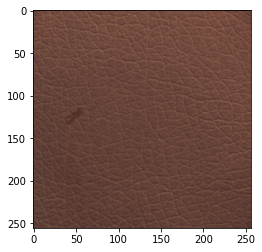

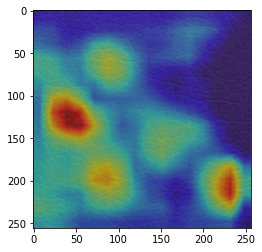

/content/drive/My Drive/Research_project/leather/test/poke/008.png
tensor([[ 0.0137, -0.0483, -0.0332,  0.0116, -0.0568, -0.0114,  0.0137,  0.0585,
         -0.0716,  0.0246]], grad_fn=<MmBackward>)


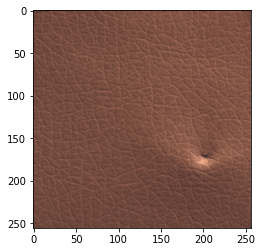

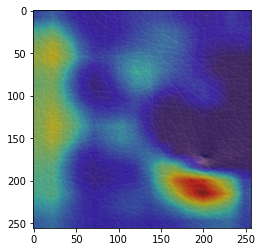

/content/drive/My Drive/Research_project/leather/test/fold/003.png
tensor([[ 0.0266, -0.0275, -0.0330, -0.0234, -0.0082,  0.0276, -0.0835,  0.0099,
          0.0060,  0.0852]], grad_fn=<MmBackward>)


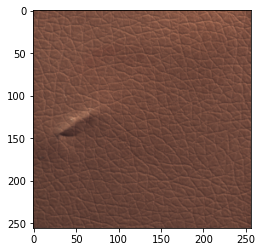

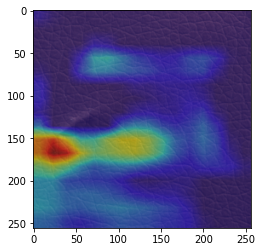

/content/drive/My Drive/Research_project/leather/test/glue/012.png
tensor([[ 0.0313,  0.0304, -0.0153,  0.0108, -0.0407,  0.0522, -0.0438, -0.0984,
         -0.0033, -0.0973]], grad_fn=<MmBackward>)


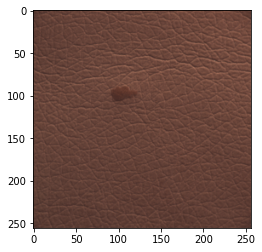

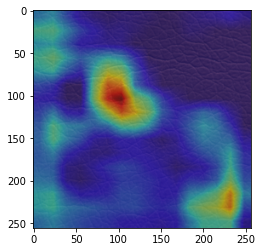

/content/drive/My Drive/Research_project/leather/test/fold/013.png
tensor([[-0.0431, -0.0797, -0.0004,  0.0083, -0.0336,  0.0184, -0.0170,  0.0674,
         -0.0536,  0.0835]], grad_fn=<MmBackward>)


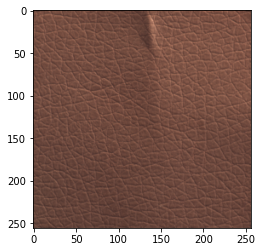

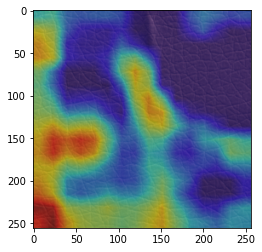

In [ ]:
Grad_Cam_Leather(test_test_bad_dataset_tensor, test_img_paths_test_bad)